## PROBLEM STATEMENT


The loan providing companies find it hard to give loans to the people due to their insufficient or non-existent credit history.
Because of that, some consumers use it to their advantage by becoming a defaulter. 
Suppose you work for a consumer finance company which specialises in lending various types of loans to urban customer.



## Business Objectives

This case study aims to identify patterns which indicate if a client has difficulty paying their instalments
which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants)
at a higher interest rate, etc. 

This will ensure that the consumers capable of repaying the loan are not rejected. 
Identification of such applicants using EDA is the aim of this case study.

In [3]:
import warnings
warnings.filterwarnings('ignore')

Importing required libraries

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [5]:
pd.set_option("display.max_rows",None)
pd.set_option("display.max_column",200)

## Dataset Importing

In [6]:
df1=pd.read_csv(r"C:\Users\lenovo pc\Downloads\application_data.csv")
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [7]:
df1.shape

(307511, 122)

In [8]:
df1.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=122)

In [9]:
df1.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

In [10]:
df1.dtypes

SK_ID_CURR                        int64
TARGET                            int64
NAME_CONTRACT_TYPE               object
CODE_GENDER                      object
FLAG_OWN_CAR                     object
FLAG_OWN_REALTY                  object
CNT_CHILDREN                      int64
AMT_INCOME_TOTAL                float64
AMT_CREDIT                      float64
AMT_ANNUITY                     float64
AMT_GOODS_PRICE                 float64
NAME_TYPE_SUITE                  object
NAME_INCOME_TYPE                 object
NAME_EDUCATION_TYPE              object
NAME_FAMILY_STATUS               object
NAME_HOUSING_TYPE                object
REGION_POPULATION_RELATIVE      float64
DAYS_BIRTH                        int64
DAYS_EMPLOYED                     int64
DAYS_REGISTRATION               float64
DAYS_ID_PUBLISH                   int64
OWN_CAR_AGE                     float64
FLAG_MOBIL                        int64
FLAG_EMP_PHONE                    int64
FLAG_WORK_PHONE                   int64


Checking nulls in the dataset 

In [11]:
perc_null = round(((df1.isnull().sum())/len(df1))*100, 2)

In [12]:
perc_null.sort_values( ascending = False)

COMMONAREA_MEDI                 69.87
COMMONAREA_AVG                  69.87
COMMONAREA_MODE                 69.87
NONLIVINGAPARTMENTS_MODE        69.43
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAPARTMENTS_MEDI        69.43
FONDKAPREMONT_MODE              68.39
LIVINGAPARTMENTS_MODE           68.35
LIVINGAPARTMENTS_AVG            68.35
LIVINGAPARTMENTS_MEDI           68.35
FLOORSMIN_AVG                   67.85
FLOORSMIN_MODE                  67.85
FLOORSMIN_MEDI                  67.85
YEARS_BUILD_MEDI                66.50
YEARS_BUILD_MODE                66.50
YEARS_BUILD_AVG                 66.50
OWN_CAR_AGE                     65.99
LANDAREA_MEDI                   59.38
LANDAREA_MODE                   59.38
LANDAREA_AVG                    59.38
BASEMENTAREA_MEDI               58.52
BASEMENTAREA_AVG                58.52
BASEMENTAREA_MODE               58.52
EXT_SOURCE_1                    56.38
NONLIVINGAREA_MODE              55.18
NONLIVINGAREA_AVG               55.18
NONLIVINGARE

In [13]:
df1.shape

(307511, 122)

In [14]:
perc_null[perc_null > 40]

OWN_CAR_AGE                     65.99
EXT_SOURCE_1                    56.38
APARTMENTS_AVG                  50.75
BASEMENTAREA_AVG                58.52
YEARS_BEGINEXPLUATATION_AVG     48.78
YEARS_BUILD_AVG                 66.50
COMMONAREA_AVG                  69.87
ELEVATORS_AVG                   53.30
ENTRANCES_AVG                   50.35
FLOORSMAX_AVG                   49.76
FLOORSMIN_AVG                   67.85
LANDAREA_AVG                    59.38
LIVINGAPARTMENTS_AVG            68.35
LIVINGAREA_AVG                  50.19
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAREA_AVG               55.18
APARTMENTS_MODE                 50.75
BASEMENTAREA_MODE               58.52
YEARS_BEGINEXPLUATATION_MODE    48.78
YEARS_BUILD_MODE                66.50
COMMONAREA_MODE                 69.87
ELEVATORS_MODE                  53.30
ENTRANCES_MODE                  50.35
FLOORSMAX_MODE                  49.76
FLOORSMIN_MODE                  67.85
LANDAREA_MODE                   59.38
LIVINGAPARTM

In [15]:
perc_null.sort_values( ascending = False)

COMMONAREA_MEDI                 69.87
COMMONAREA_AVG                  69.87
COMMONAREA_MODE                 69.87
NONLIVINGAPARTMENTS_MODE        69.43
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAPARTMENTS_MEDI        69.43
FONDKAPREMONT_MODE              68.39
LIVINGAPARTMENTS_MODE           68.35
LIVINGAPARTMENTS_AVG            68.35
LIVINGAPARTMENTS_MEDI           68.35
FLOORSMIN_AVG                   67.85
FLOORSMIN_MODE                  67.85
FLOORSMIN_MEDI                  67.85
YEARS_BUILD_MEDI                66.50
YEARS_BUILD_MODE                66.50
YEARS_BUILD_AVG                 66.50
OWN_CAR_AGE                     65.99
LANDAREA_MEDI                   59.38
LANDAREA_MODE                   59.38
LANDAREA_AVG                    59.38
BASEMENTAREA_MEDI               58.52
BASEMENTAREA_AVG                58.52
BASEMENTAREA_MODE               58.52
EXT_SOURCE_1                    56.38
NONLIVINGAREA_MODE              55.18
NONLIVINGAREA_AVG               55.18
NONLIVINGARE

In [16]:
df1.shape

(307511, 122)

In [17]:
df1.drop(perc_null[perc_null > 40].index,axis=1,inplace=True)

In [18]:
df1.shape

(307511, 73)

calculating the percentage of null values in each column

In [19]:

(df1.isnull().sum()/len(df1))*100

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.003902
AMT_GOODS_PRICE                 0.090403
NAME_TYPE_SUITE                 0.420148
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE                 0.000000
FLAG_CONT_MOBILE

Lets check each columns with null & impute them 

In [20]:
## for Ocuupation_type column
df1.OCCUPATION_TYPE.value_counts()

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

we can see here that majority of loan applicants are Laborers followed by sales staff & core staff

In [21]:
df1.OCCUPATION_TYPE.describe()

count       211120
unique          18
top       Laborers
freq         55186
Name: OCCUPATION_TYPE, dtype: object

Hence, the mojority of the applicants are laborers lets fill the null with the same

In [22]:
df1.OCCUPATION_TYPE= df1.OCCUPATION_TYPE.fillna(df1.OCCUPATION_TYPE.mode()[0])

In [23]:
df1.OCCUPATION_TYPE.isna().sum()

0

In [24]:
## For AMT.ANNUITY COLUMN

we can see here column 'AMT_ANNUITY' with less % of null values so we should replace the missing values with some value. 
lets check the column stats first  

In [25]:
df1.AMT_ANNUITY.describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

Here we can see the 3/4 quatr & the max value having a very big difference so, lets check the quantile to get a clear picture of outliers


In [26]:
df1.AMT_ANNUITY.quantile([0.5, 0.7, 0.9, 0.95,0.99]) 

0.50    24903.0
0.70    32004.0
0.90    45954.0
0.95    53325.0
0.99    70006.5
Name: AMT_ANNUITY, dtype: float64

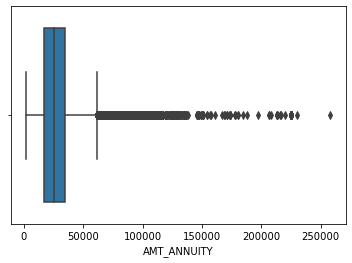

In [27]:
sns.boxplot(df1.AMT_ANNUITY)
plt.show()

From the above boxplot we can there are outliers which far range from 99% quantile hence we cannot replace the nulls with mean.
so, lets impute the missing values with median.

In [28]:
med_annuity=df1.AMT_ANNUITY.median()
med_annuity

24903.0

In [29]:
df1.AMT_ANNUITY.fillna(med_annuity,inplace=True)

In [30]:
## For AMT_GOODS_PRICE column 

In [31]:
df1.AMT_GOODS_PRICE.describe()

count    3.072330e+05
mean     5.383962e+05
std      3.694465e+05
min      4.050000e+04
25%      2.385000e+05
50%      4.500000e+05
75%      6.795000e+05
max      4.050000e+06
Name: AMT_GOODS_PRICE, dtype: float64

We can see there is much difference between mean & median which implies the presence of outliers.
So, lets fill the nulls with Median 

In [32]:
df1.AMT_GOODS_PRICE = df1.AMT_GOODS_PRICE.fillna(df1.AMT_GOODS_PRICE.median())

In [33]:
df1.AMT_GOODS_PRICE.isna().sum()

0

The other column with considerable nulls are NAME_TYPE_SUITE

In [34]:
## for NAME_TYPE_SUITE column
df1.NAME_TYPE_SUITE.describe()

count            306219
unique                7
top       Unaccompanied
freq             248526
Name: NAME_TYPE_SUITE, dtype: object

In [35]:
df1.NAME_TYPE_SUITE.value_counts()

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [36]:
df1.NAME_TYPE_SUITE= df1.NAME_TYPE_SUITE.fillna(df1.NAME_TYPE_SUITE.mode()[0])


In [37]:
df1.NAME_TYPE_SUITE.isna().sum()

0

In [38]:
## for EXT_SOURCE_2 column
df1.EXT_SOURCE_2.describe()

count    3.068510e+05
mean     5.143927e-01
std      1.910602e-01
min      8.173617e-08
25%      3.924574e-01
50%      5.659614e-01
75%      6.636171e-01
max      8.549997e-01
Name: EXT_SOURCE_2, dtype: float64

Hence there is a difference between mean & median we will replace the nulls with median 


In [39]:
df1.EXT_SOURCE_2= df1.EXT_SOURCE_2.fillna(df1.EXT_SOURCE_2.median())

In [40]:
df1.EXT_SOURCE_2.isna().sum()

0

In [41]:
## for EXT_SOURCE_3 column'

In [42]:
df1.EXT_SOURCE_3.describe()

count    246546.000000
mean          0.510853
std           0.194844
min           0.000527
25%           0.370650
50%           0.535276
75%           0.669057
max           0.896010
Name: EXT_SOURCE_3, dtype: float64

lets replace the nulls with median hence there is a difference of median & mean 

In [43]:
df1.EXT_SOURCE_3 = df1.EXT_SOURCE_3.fillna(df1.EXT_SOURCE_3.median())

In [44]:
df1.EXT_SOURCE_3.isna().sum()

0

#### AMT_REQ_CREDIT_BUREAU 

In [45]:
###lets impute nulls in AMT_REQ_CREDIT_BUREAU columns

In [46]:
df1.AMT_REQ_CREDIT_BUREAU_YEAR.fillna(df1.AMT_REQ_CREDIT_BUREAU_YEAR.mode()[0],inplace=True)
df1.AMT_REQ_CREDIT_BUREAU_QRT.fillna(df1.AMT_REQ_CREDIT_BUREAU_QRT.mode()[0],inplace=True)
df1.AMT_REQ_CREDIT_BUREAU_MON.fillna(df1.AMT_REQ_CREDIT_BUREAU_MON.mode()[0],inplace=True)
df1.AMT_REQ_CREDIT_BUREAU_WEEK.fillna(df1.AMT_REQ_CREDIT_BUREAU_WEEK.mode()[0],inplace=True)
df1.AMT_REQ_CREDIT_BUREAU_DAY.fillna(df1.AMT_REQ_CREDIT_BUREAU_DAY.mode()[0],inplace=True)
df1.AMT_REQ_CREDIT_BUREAU_HOUR.fillna(df1.AMT_REQ_CREDIT_BUREAU_HOUR.mode()[0],inplace=True)






#### OBS_CNT_SOCIAL_CIRCLE

In [47]:
####lets impute nulls in OBS_CNT_SOCIAL_CIRCLE columns


In [48]:
df1.OBS_30_CNT_SOCIAL_CIRCLE.fillna(df1.OBS_30_CNT_SOCIAL_CIRCLE.mode()[0],inplace=True)
df1.OBS_60_CNT_SOCIAL_CIRCLE.fillna(df1.OBS_60_CNT_SOCIAL_CIRCLE.mode()[0],inplace=True)
df1.DEF_30_CNT_SOCIAL_CIRCLE.fillna(df1.DEF_30_CNT_SOCIAL_CIRCLE.mode()[0],inplace=True)
df1.DEF_60_CNT_SOCIAL_CIRCLE.fillna(df1.DEF_60_CNT_SOCIAL_CIRCLE.mode()[0],inplace=True)

In [49]:
df1.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                2
REGION_RATING_CLIENT           0
REGION_RAT

We can see the columns are free from null values, now lets cross check the rows with null values 

Yeah, now we can see the dataset have no nulls. 
Let's keep the important columns & remove unwanted columns

In [50]:
not_imp= ["DAYS_LAST_PHONE_CHANGE","REGION_POPULATION_RELATIVE","FLAG_EMP_PHONE","FLAG_WORK_PHONE","FLAG_EMAIL",
              "REGION_RATING_CLIENT_W_CITY","HOUR_APPR_PROCESS_START","REG_REGION_NOT_WORK_REGION",
              "LIVE_REGION_NOT_WORK_REGION","REG_CITY_NOT_WORK_CITY","LIVE_CITY_NOT_WORK_CITY","FLAG_DOCUMENT_2",
              "FLAG_DOCUMENT_3","FLAG_DOCUMENT_4","FLAG_DOCUMENT_5","FLAG_DOCUMENT_6","FLAG_DOCUMENT_7","FLAG_DOCUMENT_8",
             "FLAG_DOCUMENT_9","FLAG_DOCUMENT_10","FLAG_DOCUMENT_11","FLAG_DOCUMENT_12","FLAG_DOCUMENT_13","FLAG_DOCUMENT_14",
             "FLAG_DOCUMENT_15","FLAG_DOCUMENT_16","FLAG_DOCUMENT_17","FLAG_DOCUMENT_18","FLAG_DOCUMENT_19","FLAG_DOCUMENT_20",
             "FLAG_DOCUMENT_21","CNT_CHILDREN","FLAG_CONT_MOBILE","FLAG_PHONE","CNT_FAM_MEMBERS","REG_REGION_NOT_LIVE_REGION",
              "REG_REGION_NOT_LIVE_REGION"]

In [51]:
df1.drop(labels=not_imp,axis=1, inplace=True)

# Lets start analysing the dataset 

In [52]:
df1.dtypes

SK_ID_CURR                      int64
TARGET                          int64
NAME_CONTRACT_TYPE             object
CODE_GENDER                    object
FLAG_OWN_CAR                   object
FLAG_OWN_REALTY                object
AMT_INCOME_TOTAL              float64
AMT_CREDIT                    float64
AMT_ANNUITY                   float64
AMT_GOODS_PRICE               float64
NAME_TYPE_SUITE                object
NAME_INCOME_TYPE               object
NAME_EDUCATION_TYPE            object
NAME_FAMILY_STATUS             object
NAME_HOUSING_TYPE              object
DAYS_BIRTH                      int64
DAYS_EMPLOYED                   int64
DAYS_REGISTRATION             float64
DAYS_ID_PUBLISH                 int64
FLAG_MOBIL                      int64
OCCUPATION_TYPE                object
REGION_RATING_CLIENT            int64
WEEKDAY_APPR_PROCESS_START     object
REG_CITY_NOT_LIVE_CITY          int64
ORGANIZATION_TYPE              object
EXT_SOURCE_2                  float64
EXT_SOURCE_3

In [53]:
#lets check gender column
df1['CODE_GENDER'].value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

we can see there are some values with gender named as 'XNA'.
which means the data was not available or customers dont like to mention.
So, lets replace these values with 'F' because female count have a majority in this case.

In [54]:
df1.CODE_GENDER = df1['CODE_GENDER'].apply(lambda x: 'F' if x == 'XNA' else x)

In [55]:
df1.CODE_GENDER.value_counts()

F    202452
M    105059
Name: CODE_GENDER, dtype: int64

See, the incorrect values were replaced with 'F'


In [56]:
## Analysis DAYS_BIRTH column

In [57]:
df1.DAYS_BIRTH.value_counts().head()

-13749    43
-13481    42
-18248    41
-10020    41
-15771    40
Name: DAYS_BIRTH, dtype: int64

we can see there are negative values, we need to replace them

In [58]:
df1.DAYS_BIRTH= df1.DAYS_BIRTH.apply(lambda x: -x if x < 0 else x)

In [59]:
df1.DAYS_BIRTH.value_counts()

13749    43
13481    42
18248    41
10020    41
15771    40
10292    40
14267    39
13263    39
11664    39
14395    39
13891    38
13480    38
15565    38
13634    38
15042    38
13788    38
14791    38
13584    38
10136    37
14790    37
10107    37
14890    37
10192    37
11108    37
16257    37
20074    37
14767    37
16690    37
15048    37
13217    37
12806    37
14276    37
15563    37
15450    37
14386    36
10519    36
11524    36
13904    36
14926    36
14137    36
13643    36
13271    36
13706    36
15322    36
14776    36
13708    36
15009    35
11135    35
12776    35
11266    35
14120    35
16830    35
14099    35
15901    35
16185    35
12682    35
15073    35
14384    35
11588    35
10978    35
10088    35
11097    35
14825    35
13254    35
13687    35
17873    35
13922    35
10223    35
12433    35
15164    35
10123    35
15155    35
10213    35
15044    35
14350    35
9981     35
14297    35
13273    35
14131    35
16490    35
16721    34
14061    34
14848    34
1035

Now the DAYS_BIRTH column got corrected, but it is clear to read the period in years. 
So, lets convert days into years by creating a new column

In [60]:
df1['AGE']= df1.DAYS_BIRTH.apply(lambda x: round(x/365))


In [61]:
df1['AGE'].head()


0    26
1    46
2    52
3    52
4    55
Name: AGE, dtype: int64

In [62]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,REGION_RATING_CLIENT,WEEKDAY_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE
0,100002,1,Cash loans,M,N,Y,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,9461,-637,-3648.0,-2120,1,Laborers,2,WEDNESDAY,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,26
1,100003,0,Cash loans,F,N,N,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,16765,-1188,-1186.0,-291,1,Core staff,1,MONDAY,0,School,0.622246,0.535276,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46
2,100004,0,Revolving loans,M,Y,Y,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,19046,-225,-4260.0,-2531,1,Laborers,2,MONDAY,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,52
3,100006,0,Cash loans,F,N,Y,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,19005,-3039,-9833.0,-2437,1,Laborers,2,WEDNESDAY,0,Business Entity Type 3,0.650442,0.535276,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,52
4,100007,0,Cash loans,M,N,Y,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,19932,-3038,-4311.0,-3458,1,Core staff,2,THURSDAY,0,Religion,0.322738,0.535276,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,55


In [63]:
##Drop DAYS_BIRTH column
df1.drop("DAYS_BIRTH",inplace=True,axis=1)

In [64]:
df1.DAYS_EMPLOYED.value_counts().head()

 365243    55374
-200         156
-224         152
-230         151
-199         151
Name: DAYS_EMPLOYED, dtype: int64

In [65]:
df1.DAYS_EMPLOYED= df1.DAYS_EMPLOYED.apply(lambda x: -x if x < 0 else x)

In [66]:
df1.DAYS_EMPLOYED.value_counts()

365243    55374
200         156
224         152
230         151
199         151
212         150
384         143
229         143
231         140
215         138
207         138
216         137
188         137
196         136
116         136
222         135
193         134
195         133
214         132
254         131
213         131
201         130
381         130
233         128
185         128
194         127
237         127
184         126
234         126
209         125
348         125
241         124
745         123
137         123
382         122
139         122
198         122
238         122
218         120
240         120
205         120
191         120
118         119
223         119
225         119
181         118
430         118
244         118
227         118
268         117
370         117
133         117
132         117
228         117
115         117
119         116
204         116
129         116
109         115
391         115
236         115
206         115
208     

Here we can see there are 55374 employes with employed a fixed days '365243'. 
If we convert this into years it comes 1000 years which is not possible.

In [67]:
df1.DAYS_EMPLOYED.value_counts(normalize = True) * 100


365243    18.007161
200        0.050730
224        0.049429
230        0.049104
199        0.049104
212        0.048779
384        0.046502
229        0.046502
231        0.045527
215        0.044876
207        0.044876
216        0.044551
188        0.044551
196        0.044226
116        0.044226
222        0.043901
193        0.043576
195        0.043250
214        0.042925
254        0.042600
213        0.042600
201        0.042275
381        0.042275
233        0.041625
185        0.041625
194        0.041299
237        0.041299
184        0.040974
234        0.040974
209        0.040649
348        0.040649
241        0.040324
745        0.039999
137        0.039999
382        0.039673
139        0.039673
198        0.039673
238        0.039673
218        0.039023
240        0.039023
205        0.039023
191        0.039023
118        0.038698
223        0.038698
225        0.038698
181        0.038373
430        0.038373
244        0.038373
227        0.038373
268        0.038047


We can see there are 18% employees with '365243' employed days.
let's check employement type of them .

In [68]:
df1[df1['DAYS_EMPLOYED'] == 365243].NAME_INCOME_TYPE.value_counts()

Pensioner     55352
Unemployed       22
Name: NAME_INCOME_TYPE, dtype: int64

So, there are 55352 pensioners with working days as '365243'
what we can do is leave the data here & work on this, impute this later.

In [69]:
df1.DAYS_REGISTRATION.value_counts().head()

-1.0    113
-7.0     98
-6.0     96
-4.0     92
-2.0     92
Name: DAYS_REGISTRATION, dtype: int64

In [70]:
df1.DAYS_REGISTRATION = df1.DAYS_REGISTRATION.apply(lambda x: -x if x < 0 else x)

In [71]:
df1.DAYS_REGISTRATION.value_counts().head()

1.0    113
7.0     98
6.0     96
4.0     92
2.0     92
Name: DAYS_REGISTRATION, dtype: int64

In [72]:
df1.DAYS_ID_PUBLISH .value_counts().head()

-4053    169
-4095    162
-4046    161
-4417    159
-4256    158
Name: DAYS_ID_PUBLISH, dtype: int64

In [73]:
df1.DAYS_ID_PUBLISH  = df1.DAYS_ID_PUBLISH .apply(lambda x: -x if x < 0 else x)

In [74]:
df1.DAYS_ID_PUBLISH.value_counts().head()

4053    169
4095    162
4046    161
4417    159
4256    158
Name: DAYS_ID_PUBLISH, dtype: int64

lets convert the days into years that id published.

In [75]:
df1.YEARS_ID_PUBLISH = df1.DAYS_ID_PUBLISH.apply(lambda x: round(x/365))

In [76]:
df1.YEARS_ID_PUBLISH

0          6
1          1
2          7
3          7
4          9
5          1
6          2
7          7
8         10
9         11
10         2
11         7
12         9
13        13
14         6
15         4
16        11
17         7
18         3
19        11
20         5
21         6
22         7
23        10
24        10
25         8
26         5
27         9
28         7
29         8
30        10
31         8
32        12
33        10
34        11
35         6
36         2
37        12
38        14
39        12
40         3
41         1
42        12
43        13
44         7
45         2
46         5
47         9
48         9
49         5
50         7
51         5
52         5
53         3
54         6
55        14
56         4
57         5
58        14
59         2
60         6
61         2
62        11
63        12
64        11
65         0
66         8
67         8
68        11
69        10
70        10
71        11
72         3
73        10
74        12
75         3
76         8

In [77]:
df1.ORGANIZATION_TYPE.value_counts()

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

##### -There are ~55k XNA values

In [78]:
df1.NAME_INCOME_TYPE.value_counts()

Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

we can see all thee ~55k are Pensioners, let's impute them with pensioners in Organisation type

In [79]:
df1.ORGANIZATION_TYPE=df1.ORGANIZATION_TYPE.replace("XNA","Pensioner")

lets check the object type variables

In [80]:
objects= ["NAME_INCOME_TYPE","NAME_EDUCATION_TYPE","NAME_FAMILY_STATUS","NAME_HOUSING_TYPE","WEEKDAY_APPR_PROCESS_START","ORGANIZATION_TYPE"]

In [81]:
for i in objects:
    print(df1[i].value_counts())
    print('***************************************')

Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64
***************************************
Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary                    3816
Academic degree                     164
Name: NAME_EDUCATION_TYPE, dtype: int64
***************************************
Married                 196432
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, dtype: int64
***************************************
House / apartment      272868
With parents            14840
Municipal apartment     11183
Rented apartment         4881
Office apa

In [82]:
df1.TARGET.value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

LETS CHECK OUTLIERS IN THE DATASET 

In [83]:
df1.nunique().sort_values()

FLAG_MOBIL                         2
TARGET                             2
NAME_CONTRACT_TYPE                 2
CODE_GENDER                        2
FLAG_OWN_CAR                       2
FLAG_OWN_REALTY                    2
REG_CITY_NOT_LIVE_CITY             2
REGION_RATING_CLIENT               3
AMT_REQ_CREDIT_BUREAU_HOUR         5
NAME_EDUCATION_TYPE                5
NAME_FAMILY_STATUS                 6
NAME_HOUSING_TYPE                  6
NAME_TYPE_SUITE                    7
WEEKDAY_APPR_PROCESS_START         7
NAME_INCOME_TYPE                   8
AMT_REQ_CREDIT_BUREAU_WEEK         9
DEF_60_CNT_SOCIAL_CIRCLE           9
AMT_REQ_CREDIT_BUREAU_DAY          9
DEF_30_CNT_SOCIAL_CIRCLE          10
AMT_REQ_CREDIT_BUREAU_QRT         11
OCCUPATION_TYPE                   18
AMT_REQ_CREDIT_BUREAU_MON         24
AMT_REQ_CREDIT_BUREAU_YEAR        25
OBS_60_CNT_SOCIAL_CIRCLE          33
OBS_30_CNT_SOCIAL_CIRCLE          33
AGE                               49
ORGANIZATION_TYPE                 58
E

In [84]:
# BOXPLOT FOR AMT_INCOME_TOTAL

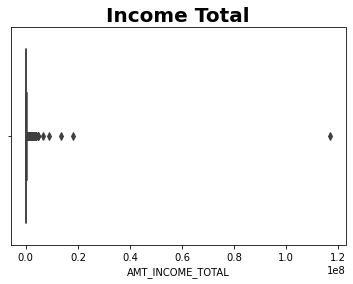

<Figure size 576x144 with 0 Axes>

In [85]:
sns.boxplot(df1.AMT_INCOME_TOTAL)
plt.title("Income Total",fontdict={"fontsize":20,"fontweight":"bold"})
plt.figure(figsize=(8,2))
plt.show()

We can see there are outliers with high income total from the mboxplot to check the details lets check with quantile

In [86]:
df1.AMT_INCOME_TOTAL.quantile([0.5,0.9,0.95,0.999,1])

0.500       147150.0
0.900       270000.0
0.950       337500.0
0.999       900000.0
1.000    117000000.0
Name: AMT_INCOME_TOTAL, dtype: float64

So, the max value it is showing a large difference from 0.999 quantile
but we cannot delete this may the customer is having such high income

In [87]:
#### for AMT_CREDIT column

In [88]:
df1.AMT_CREDIT.describe()

count    3.075110e+05
mean     5.990260e+05
std      4.024908e+05
min      4.500000e+04
25%      2.700000e+05
50%      5.135310e+05
75%      8.086500e+05
max      4.050000e+06
Name: AMT_CREDIT, dtype: float64

lets plot a boxplot for this column & check outliers 

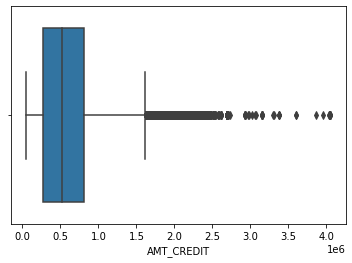

In [89]:
sns.boxplot(df1.AMT_CREDIT)
plt.show()

In [90]:
df1.AMT_CREDIT.quantile([0.5,0.75,0.9,0.95,0.99,1])

0.50     513531.0
0.75     808650.0
0.90    1133748.0
0.95    1350000.0
0.99    1854000.0
1.00    4050000.0
Name: AMT_CREDIT, dtype: float64

In [91]:
df1[df1.AMT_CREDIT>2000000].shape

(2029, 37)

Here we can see there more than 2000 cases where the outliers are there.
we cannot delete these values to proceed with analysis.

In [92]:
## lets analyse the AMT_ANNUITY column 


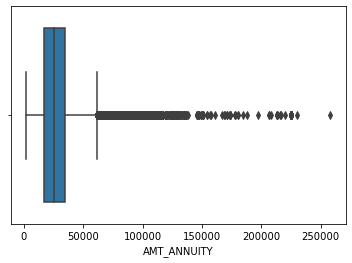

In [93]:
sns.boxplot(df1.AMT_ANNUITY)
plt.show()

In [94]:
df1.AMT_ANNUITY.quantile([0,0.3,0.4,0.5,0.75,0.99,1])

0.00      1615.5
0.30     18189.0
0.40     21870.0
0.50     24903.0
0.75     34596.0
0.99     70006.5
1.00    258025.5
Name: AMT_ANNUITY, dtype: float64

In [95]:
df1[df1.AMT_ANNUITY>75000].shape

(1976, 37)

We can see morethan 1900 values are outliers in AMT_ANNUITY column

#### AMT_GOODS_PRICE 

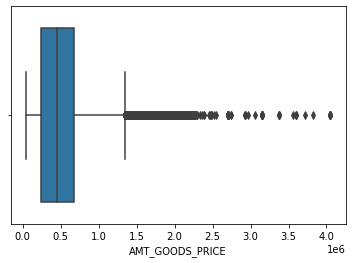

In [96]:
## lets plot a boxplot for AMT_GOODS_PRICE column
sns.boxplot(df1.AMT_GOODS_PRICE)
plt.show()

In [97]:
df1.AMT_GOODS_PRICE.quantile([0.3,0.5,0.75,0.99,1])

0.30     270000.0
0.50     450000.0
0.75     679500.0
0.99    1800000.0
1.00    4050000.0
Name: AMT_GOODS_PRICE, dtype: float64

In [98]:
df1[df1.AMT_GOODS_PRICE>1800000].shape

(1431, 37)

#### Lets check the imbalance ratio in the Target variable

In [99]:
df1.TARGET.dtype

dtype('int64')

In [100]:
## Lets convert target value as a string datatype
df1.TARGET.astype(str).head()

0    1
1    0
2    0
3    0
4    0
Name: TARGET, dtype: object

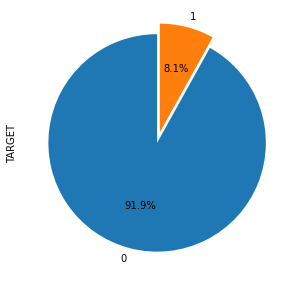

In [101]:
##lets plot a piechart to see the defaulters & on time payers
plt.figure(figsize=[5,5])
df1.TARGET.value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',startangle=90)
plt.show()

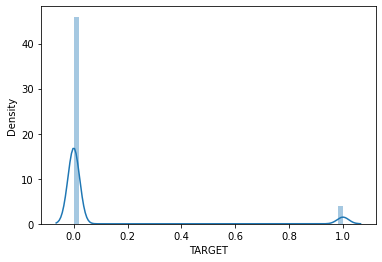

In [102]:
## lets see what distplot looks like
sns.distplot(df1.TARGET)
plt.show()

In [103]:
df1.TARGET.value_counts(normalize=True)*100

0    91.927118
1     8.072882
Name: TARGET, dtype: float64

In [104]:
#lets calculate the imbalance ratio to get a clear idea 
len(df1[df1.TARGET==1])/len(df1[df1.TARGET==0])

0.08781828601345662

### The imbalance ratio comes as 0.087 which is ~9% of the people facing payment difficulties

# Binning the continuous variable 

In [105]:
# lets Create Bins for AMT_INCOME_TOTAL variable
bins=[0,100000,200000,300000,400000,1000000000]
# Creating labels
bin_values=["Very Low(<1L)","Low(1L-2L)","Medium(2L-3L)","High(3L-5L)","Very High(5L+ )"]
df1["INCOME_RANGE"] =pd.cut(df1.AMT_INCOME_TOTAL,bins,labels=bin_values)

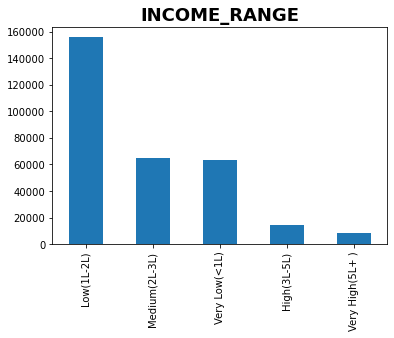

In [106]:
df1.INCOME_RANGE.value_counts().plot.bar()
plt.title("INCOME_RANGE",fontdict={"fontsize":18,"fontweight":"bold"})
plt.show()

FROM THE BAR PLOT WE CAN SEE THE MAJORITY OF THEIR INCOME LIES IN 1-2l range

In [107]:
## lets create bins for AMT_CREDIT variable
bins=[0,100000,200000,400000,600000,1000000,2500000,5000000]


In [108]:
# Creating labels
AMT_CREDIT_labels=["<1L","1L-2L","2L-4L","4L-6L","6L-10L","10L-25L","25L +",]
df1["AMT_CREDIT_BINS"]=pd.cut(df1.AMT_CREDIT,bins,labels=AMT_CREDIT_labels)

In [109]:
df1.AMT_CREDIT_BINS.value_counts(normalize=True)*100

2L-4L      26.389625
6L-10L     24.051497
4L-6L      21.550449
10L-25L    16.137309
1L-2L       9.801275
<1L         1.952450
25L +       0.117394
Name: AMT_CREDIT_BINS, dtype: float64

26% of the people having a CREDIT LOAN in the range 2L-4L
24% of the people having a CREDIT LOAN in the range 6L-10L


### BINNING THE AGE GROUP

In [110]:
#Creatng Bins
bins=[20,30,40,50,60,70]
##LETS CREATE LABELS
labels=["Below 30's","In 30's","In 40's","In 50's","In 60's"]
df1["Age_Bins"]=pd.cut(df1.AGE,bins,labels=labels)


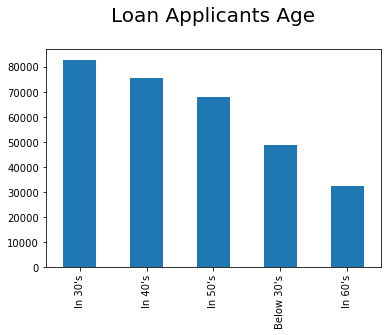

In [111]:
df1.Age_Bins.value_counts().plot.bar()
plt.title("Loan Applicants Age\n",fontdict={'fontsize':20,'color':'black'})
plt.show()

In [112]:
df1.Age_Bins.value_counts(normalize=True)*100

In 30's       26.916110
In 40's       24.554894
In 50's       22.098396
Below 30's    15.891789
In 60's       10.538810
Name: Age_Bins, dtype: float64

~27% are in the age of 30's & ~24% are in the range of 40's

In [113]:
#### UNIVARIATE ANALYSIS OF CATEGORICAL COLUMNS

Distribution of INCOME over TARGET

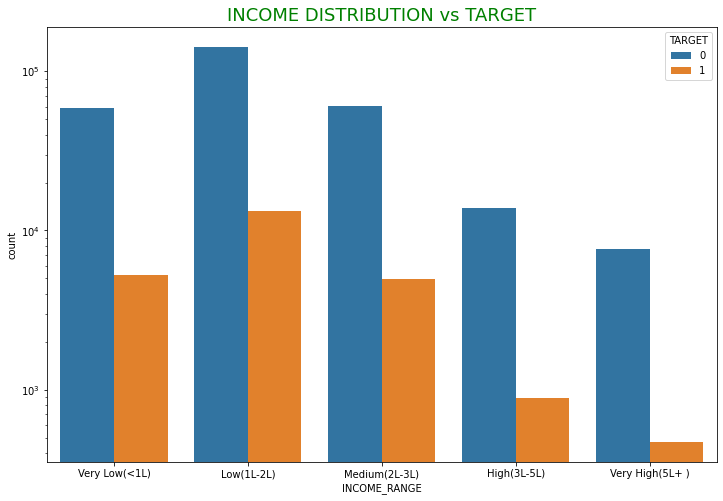

In [114]:
## Let's Plot Income distribution
plt.figure(figsize=[12,8])
sns.countplot(df1['INCOME_RANGE'],hue=df1["TARGET"])
plt.title("INCOME DISTRIBUTION vs TARGET",fontdict={'fontsize':18,'color':'green'})
plt.yscale("log")
plt.show()

OBSERVATIONS: People  with income in the range of 5Lakhs+ find less difficulties or pay loans on-time.

### CREDIT AMOUNT

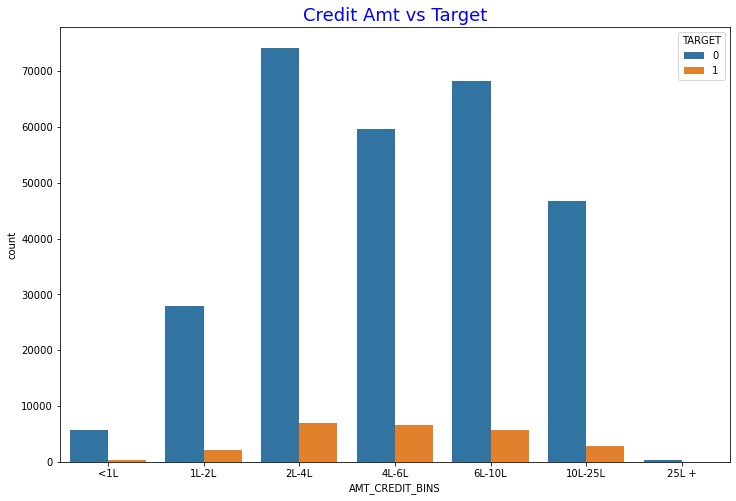

In [115]:
##let's plot countplot for CREDIT_AMOUNT Variable
plt.figure(figsize=[12,8])
sns.countplot(df1['AMT_CREDIT_BINS'],hue=df1.TARGET)
plt.title("Credit Amt vs Target",fontdict={'fontsize':18,'color':'blue'})
plt.show()

OBSERVATIONS: 
    1.Most of the defaulters chooses the credit loan in the range of 2-4Lakhs.
    2.Applicants who took highest & lowest range of credit loan havinf less difficulty in repaying.

### Age distribution 

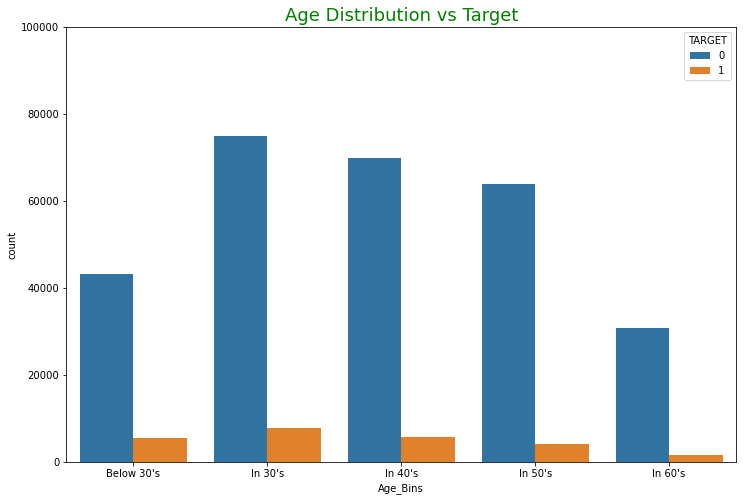

In [116]:
##Let's plot Age distribution countplot
plt.figure(figsize=[12,8])
sns.countplot(df1['Age_Bins'],hue=df1["TARGET"])

#Limiting the y scale for clear understanding
plt.ylim(0,100000)

plt.title("Age Distribution vs Target",fontdict={'fontsize':18,'color':'green'})
plt.show()

OBSERVATIONS: Applicants in the age of 30's find less difficulty in repaying loan.

### PLOTTING FOR INCOME TYPE

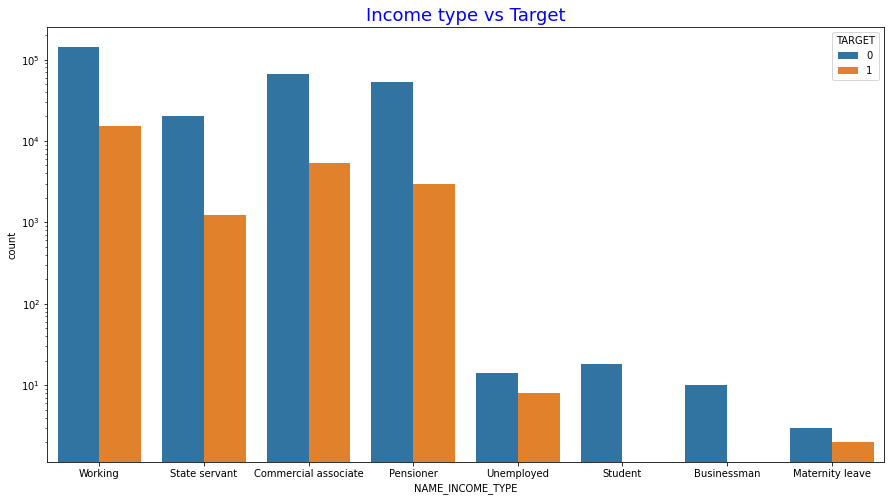

In [117]:
### lets plot a distplot for income type 
plt.figure(figsize=[15,8])
sns.countplot(df1['NAME_INCOME_TYPE'],hue=df1.TARGET)
plt.title("Income type vs Target",fontdict={'fontsize':18,'color':'blue'})
### lets take a log scale 
plt.yscale("log")
plt.show()

OBSEVATIONS: 
    1.Working people have high tendency to repay the loan,
    maternity & unemployed showing more defaulty in repaying loan.
    2.Students & businessman showing no records of defaults so we can consider approach them.
    

### plotting Gender column 

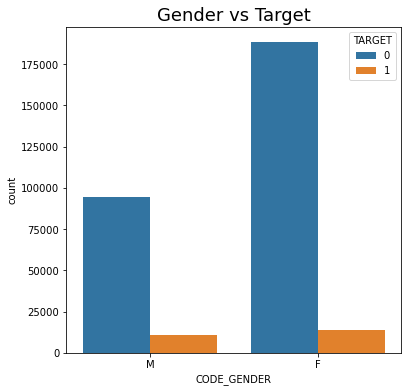

In [118]:
### for gender column 
plt.figure(figsize=[6,6])
sns.countplot(df1['CODE_GENDER'],hue=df1.TARGET)
plt.title("Gender vs Target",fontdict={'fontsize':18,'color':'black'})
plt.show()

OBSERVATIONS: Bank should consider females more because they show majorit in loan payment 

## Plotting Contract type column

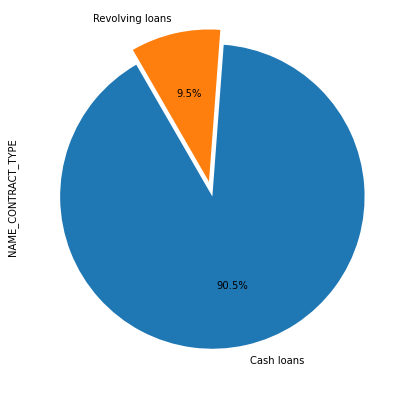

In [119]:
## Lets check on Contract type column on piechart
plt.figure(figsize=[7,7])
df1.NAME_CONTRACT_TYPE.value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',startangle=120)
plt.show()

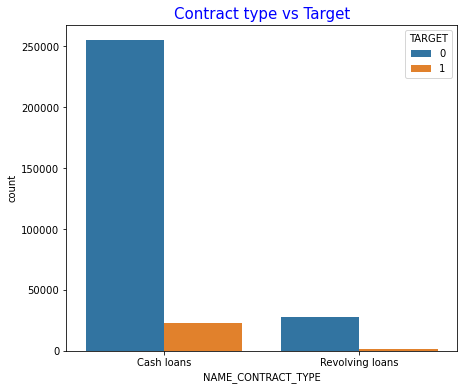

In [120]:
### lets see the same variabe on countplot
plt.figure(figsize=[7,6])
sns.countplot(df1['NAME_CONTRACT_TYPE'],hue=df1.TARGET)
plt.title("Contract type vs Target",fontdict={'fontsize':15,'color':'blue'})
plt.show()

OBSERVATIONS: 1.Here we can see that 92% were csh loan and also from the count plot,
              it is clear that cash loan have more on-time payers & majority in numbers of applicants but
              revolving loans shows less defaulters so banks should give more revolving loans.

#### OCCUPATION VARIABLE 

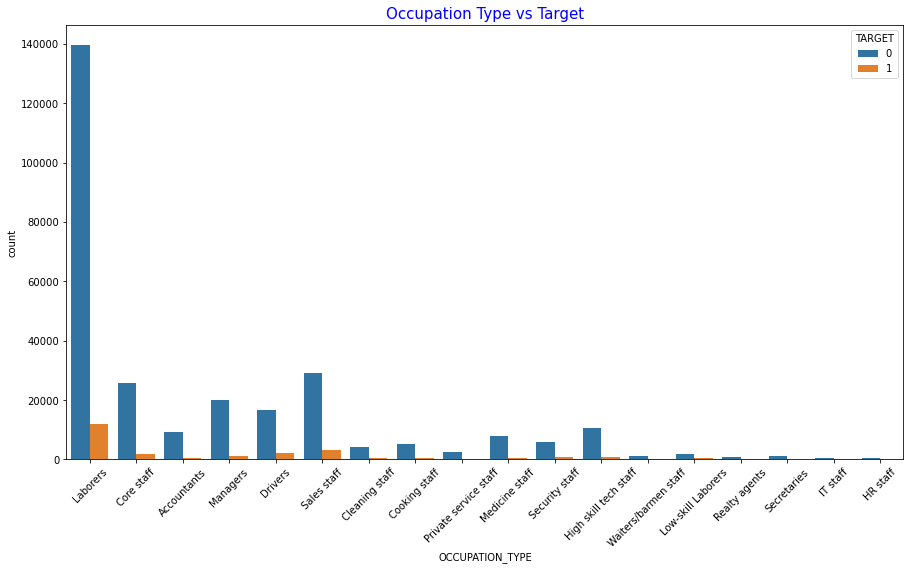

In [121]:
##Lets plot one of the interesting variable i.e Occupation 

plt.figure(figsize=[15,8])
sns.countplot(df1['OCCUPATION_TYPE'],hue=df1.TARGET)
plt.title("Occupation Type vs Target",fontdict={'fontsize':15,'color':'blue'})
plt.xticks(rotation=45)
plt.show()

### OBSERVATIONS: 
####    1.We can see here the majority of the applicants are laborers who repays ontime 
####    2.Followed by Sales staff in on-time payers.
####    3.Banks can put less focus on High skill tech , IT, HR staff 

### Housing type 

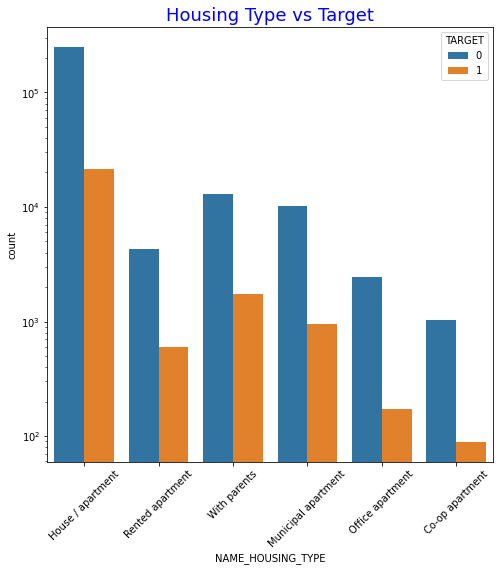

In [122]:
##lets plot Housing type
plt.figure(figsize=[8,8])
sns.countplot(df1['NAME_HOUSING_TYPE'],hue=df1.TARGET)
plt.title("Housing Type vs Target",fontdict={'fontsize':18,'color':'blue'})
plt.xticks(rotation=45)
plt.yscale("log")
plt.show()

### OBSERVATIONS: 
####    1.Applicants who are living Co-operative apartments to be focused more which show less defaulters.
####    2.House/apartment housing applicants shows more defaulters.

### Organisation type


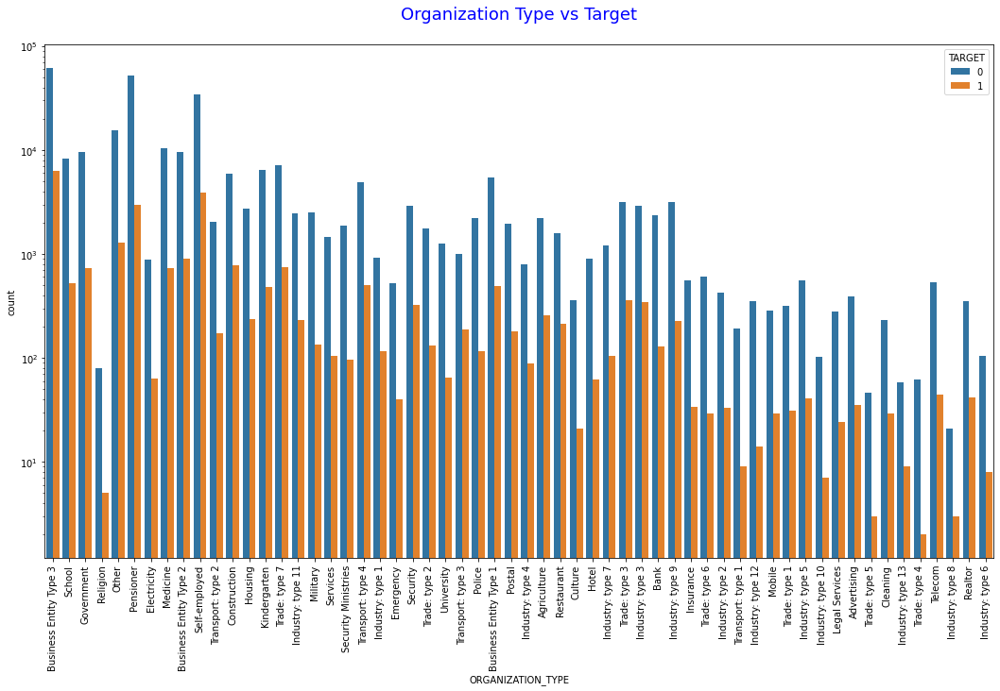

In [123]:
##lets plot organisation type vs Target variable
plt.figure(figsize=[18,10])
sns.countplot(df1["ORGANIZATION_TYPE"],hue=df1.TARGET,orient='h')
plt.title("Organization Type vs Target\n",fontdict={'fontsize':18,'color':'blue'})
plt.xticks(rotation=90)
plt.yscale("log")
plt.show()

### OBSERVATIONS: 
####    1.Business entity type-3 shows majority in defaulters followed by self-employed & pensioners
####    2.security ministers, religion, military, services, electricity are some professions
####    with comparitively less majority in defaulter.

## Region rating 

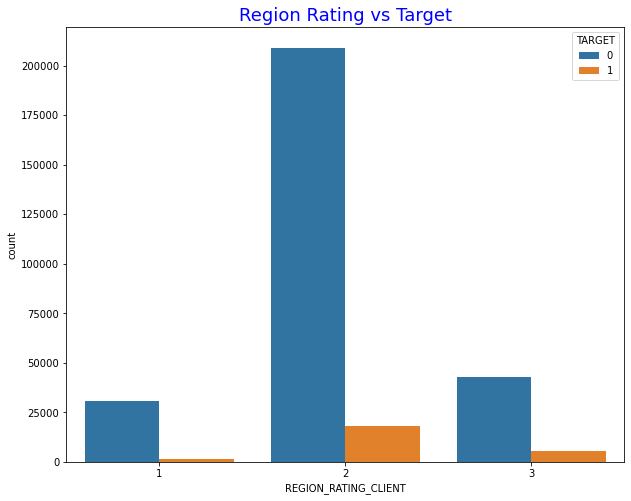

In [124]:
## lets plot refion rating vs Target 
plt.figure(figsize=[10,8])
sns.countplot(df1["REGION_RATING_CLIENT"],hue=df1.TARGET)
plt.title("Region Rating vs Target",fontdict={'fontsize':18,'color':'blue'})
plt.show()

### OBSERVATIONS:
####    1. Region rating 2 have majority in ontime-payers banks should focus on this.
####    2.Region rating 3 show comparitively more defaulters 

#### lets split the data frame on the basis on Target variable


In [125]:
tar1= df1[df1.TARGET==1]
tar0= df1[df1.TARGET==0]

In [126]:
#### lets merge Organization type with Target variable
v1=tar0.groupby(by="ORGANIZATION_TYPE",as_index=False)["TARGET"].count()
v2=tar1.groupby(by="ORGANIZATION_TYPE",as_index=False)["TARGET"].count()
v2.columns=["ORGANIZATION_TYPE","TARGET_1"]
v1=v1.merge( v2,on="ORGANIZATION_TYPE")
v1.columns=["ORGANIZATION_TYPE","TARGET_0","TARGET_1"]

# Adding a new column -- percentage of defaulters
v1["Defaulters_%"]=(v1["TARGET_1"]/(v1["TARGET_0"] + v1["TARGET_1"]))*100

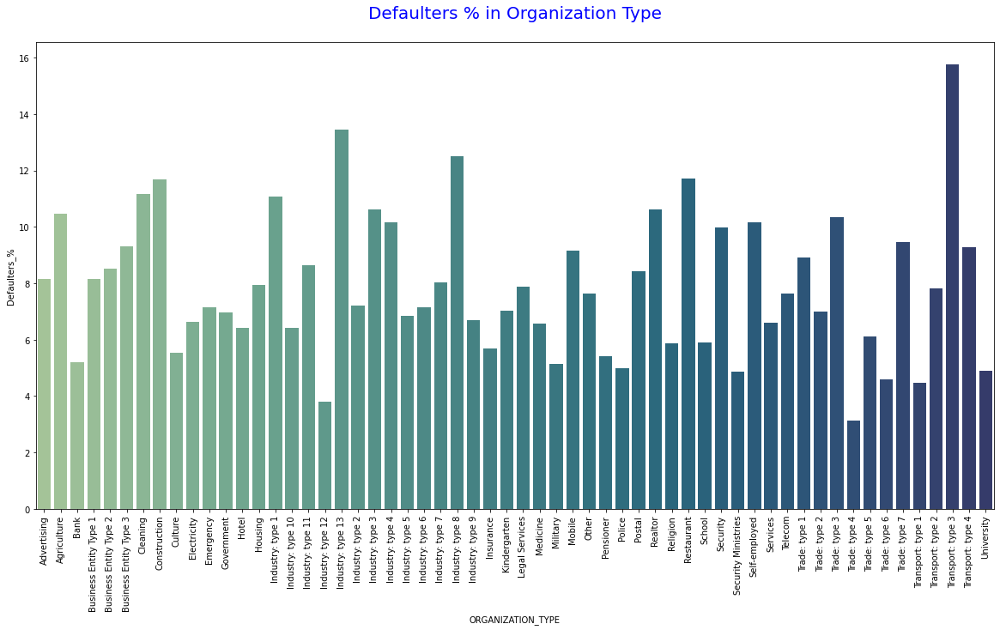

In [127]:
#### lETS PLOT DEFAULTER % wrt ORGANIZATION TYPE 
plt.figure(figsize=[20,10])
sns.barplot(data=v1,x="ORGANIZATION_TYPE",y="Defaulters_%",palette="crest")
plt.title("Defaulters % in Organization Type\n",fontdict={'fontsize':20,'color':'blue'})
plt.xticks(rotation=90)
plt.show()

### OBSERVATIONS:
####    1.Transport type3 shows more defaulters 
####    2.Trade type 4 shows less % of defaulter 

### BIVARIATE ANALYSIS 

#### NUMERIC-NUMERIC TYPE


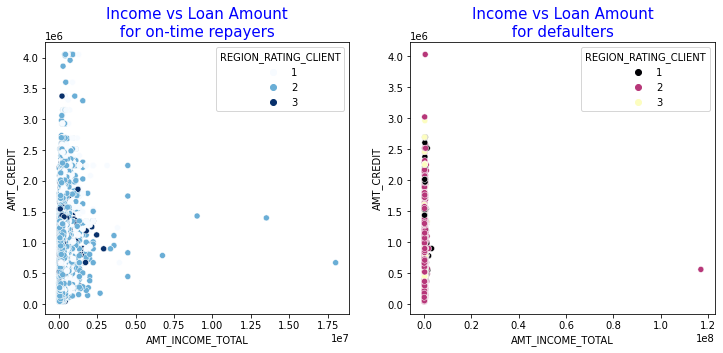

In [128]:
## Lets plot some numeric variable wrt numerical variables on scatter plot
plt.figure(figsize = [12,5])

#Plotting scatter plot for Income vs Loan Amount for on time Repayers
plt.subplot(1,2,1)
sns.scatterplot(data=tar0,x="AMT_INCOME_TOTAL",y="AMT_CREDIT",hue='REGION_RATING_CLIENT',palette="Blues")
plt.title("Income vs Loan Amount\n for on-time repayers ",fontdict={"fontsize":15,"color":'blue'})

#Plotting scatter plot for Income vs Loan Amount for defaulters
plt.subplot(1,2,2)
sns.scatterplot(data=tar1,x="AMT_INCOME_TOTAL",y="AMT_CREDIT",hue='REGION_RATING_CLIENT',palette="magma")
plt.title("Income vs Loan Amount\n for defaulters ",fontdict={"fontsize":15,"color":'blue'})
plt.show()

OBSERVATIONS: 
    1.We can see that more income people having are more on-time payers & eligible for high credit loans. 
    2.Region rating 2  with more income shows on more on-time payers

### AMT_CREDIT VS AMT_GOODS_PRICE 

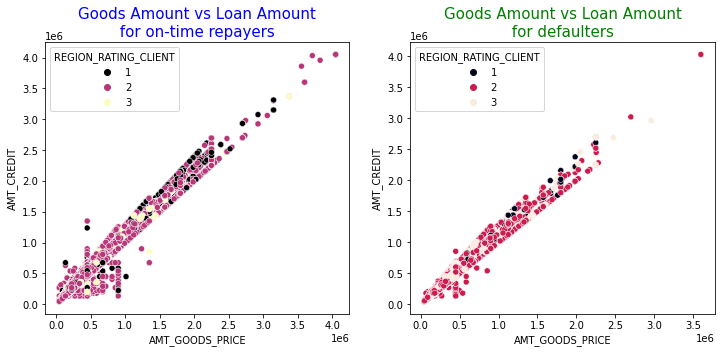

In [129]:
## LETS PLOT SOME NUMERICAL-NUMERICAL WITH AMT_CREDIT WRT AMT_GOODS_PRICE
plt.figure(figsize = [12,5])
#Plotting scatter plot for Goods Amount vs Loan Amount for on time Repayers
plt.subplot(1,2,1)
sns.scatterplot(data=tar0,x="AMT_GOODS_PRICE",y="AMT_CREDIT",hue='REGION_RATING_CLIENT',palette="magma")
plt.title("Goods Amount vs Loan Amount\n for on-time repayers ",fontdict={"fontsize":15,"color":'blue'})

#Plotting scatter plot for Goods Amount vs Loan Amount for defaulters
plt.subplot(1,2,2)
sns.scatterplot(data=tar1,x="AMT_GOODS_PRICE",y="AMT_CREDIT",hue='REGION_RATING_CLIENT',palette='rocket')
plt.title("Goods Amount vs Loan Amount\n for defaulters ",fontdict={"fontsize":15,"color":'green'})
plt.show()

### OBSERVATIONS:
####    1. High amount goods price shows more credit loans & shows linear relation 
####    2. Rating region 2 shows high credit loans & much on-time payers 
    

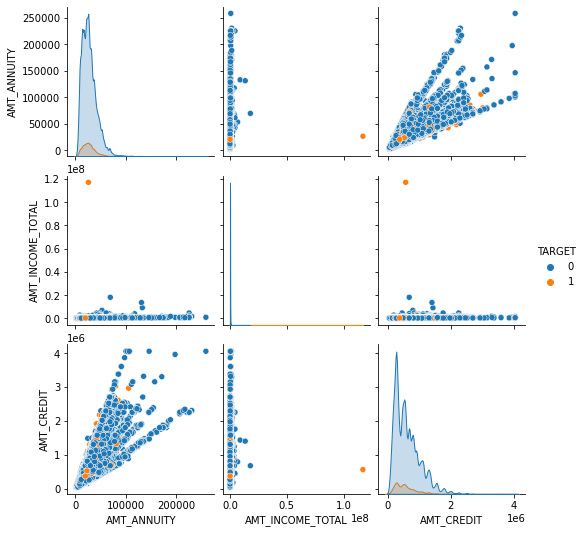

In [130]:
### lets plot numerical variables on pair plot to get clear comparision
NUM=df1[["AMT_ANNUITY","AMT_INCOME_TOTAL","AMT_CREDIT","TARGET"]]
sns.pairplot(NUM,hue='TARGET')
plt.show()

### OBSERATIONS:
####    1. We can see that when the credit loan is high ~ 30lakhs & Annuity of 1lakhs applicants paid on time 

### BIVARIATE CATEGORICAL-NUMERICAL

In [131]:
#### INCOME WRT EDUCATION FOR TARGET VARIABLE

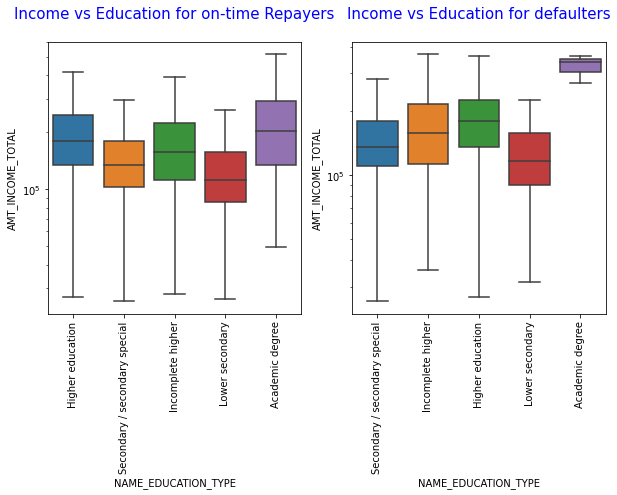

In [132]:
plt.figure(figsize=[10,5])

# Bivariate Analysis for Income Amount vs Education Type wrt on time repayers
plt.subplot(1,2,1)   
sns.boxplot(data=tar0,x="NAME_EDUCATION_TYPE",y="AMT_INCOME_TOTAL",showfliers=False)
plt.title("Income vs Education for on-time Repayers\n",fontdict={"fontsize":15,'color':"blue"})
plt.yscale("log")
plt.xticks(rotation=90)

# Bivariate Analysis for Income Amount vs Education Type wrt on Defaulters
plt.subplot(1,2,2)
sns.boxplot(data=tar1,x="NAME_EDUCATION_TYPE",y="AMT_INCOME_TOTAL",showfliers=False)
plt.title("Income vs Education for defaulters\n",fontdict={"fontsize":15,'color':"blue"})
plt.yscale("log")
plt.xticks(rotation=90)
plt.show()

### OBSERVATIONS:
####    1. Academic degree holder with high income pays on-time followed by higher education category
####    2. Also the income of applicants with academic degree shows cluster for defaulters

#### BIVARIATE ANALYSIS OF AMT CREDIT WRT EDUACTION CATEGORY FOR TARGET VARIABLE

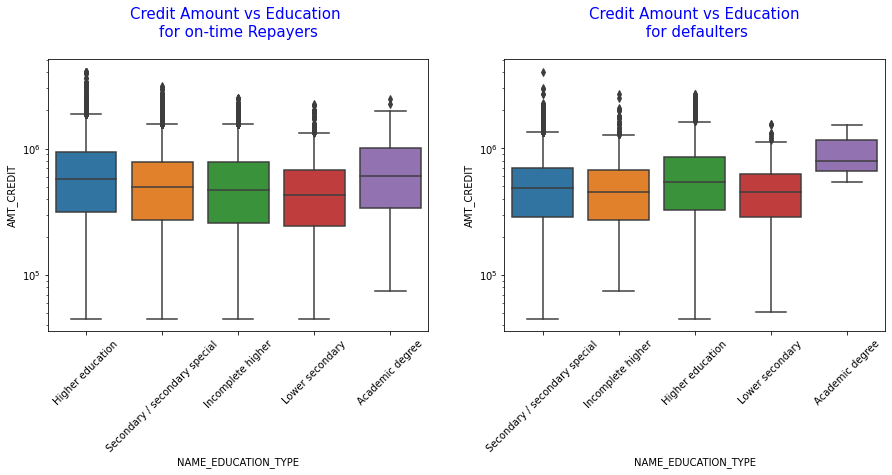

In [133]:
plt.figure(figsize=[15,5])

#Bivariate Analysis for Credit Amount vs Education Type wrt on time Repayers
plt.subplot(1,2,1)
sns.boxplot(data=tar0,x="NAME_EDUCATION_TYPE",y="AMT_CREDIT")
plt.title("Credit Amount vs Education \nfor on-time Repayers\n",fontdict={"fontsize":15,'color':"blue"})
plt.yscale("log")
plt.xticks(rotation=45)

#Bivariate Analysis for Credit Amount vs Education Type wrt defaulters
plt.subplot(1,2,2)
sns.boxplot(data=tar1,x="NAME_EDUCATION_TYPE",y="AMT_CREDIT")
plt.title("Credit Amount vs Education\n for defaulters\n",fontdict={"fontsize":15,'color':"blue"})
plt.yscale("log")
plt.xticks(rotation=45)
plt.show()

### OBSERVATIONS:
####    1 Academic degree applicants having high credit loans pays ontime followed by higher education people.
####    2 Academic degree applicants shows high defaults cluster with high credit loans.

## CORRELATION

#### Correlation matrix for Target=0

In [134]:
#LETS SEE CORRELATION MATRIX FOR TAR_0
corr_tar0= round(tar0.corr(),2)
corr_tar0

,SK_ID_CURR,TARGET,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,REGION_RATING_CLIENT,REG_CITY_NOT_LIVE_CITY,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE
SK_ID_CURR,1.0,NaN,0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,0.0,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00
TARGET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AMT_INCOME_TOTAL,0.0,NaN,1.00,0.34,0.42,0.35,-0.14,-0.06,-0.02,0.0,-0.19,0.01,0.14,-0.06,-0.03,-0.03,-0.03,-0.03,0.00,0.01,0.01,0.06,0.02,0.04,-0.06
AMT_CREDIT,-0.0,NaN,0.34,1.00,0.77,0.99,-0.07,-0.01,0.00,0.0,-0.10,-0.03,0.13,0.03,-0.00,-0.02,-0.00,-0.02,-0.00,0.01,0.00,0.06,0.02,-0.03,0.05
AMT_ANNUITY,0.0,NaN,0.42,0.77,1.00,0.78,-0.10,-0.04,-0.01,0.0,-0.13,-0.01,0.13,0.02,-0.01,-0.02,-0.01,-0.02,0.00,0.00,0.01,0.04,0.01,-0.01,-0.01
AMT_GOODS_PRICE,-0.0,NaN,0.35,0.99,0.78,1.00,-0.07,-0.02,0.00,0.0,-0.10,-0.02,0.14,0.03,-0.00,-0.02,-0.00,-0.02,-0.00,0.01,0.00,0.06,0.02,-0.03,0.04
DAYS_EMPLOYED,0.0,NaN,-0.14,-0.07,-0.10,-0.07,1.00,0.21,0.28,0.0,0.04,-0.09,-0.03,0.10,0.01,0.02,0.01,0.02,-0.00,-0.00,0.00,-0.03,0.01,0.04,0.63
DAYS_REGISTRATION,0.0,NaN,-0.06,-0.01,-0.04,-0.02,0.21,1.00,0.10,0.0,-0.08,-0.06,0.05,0.09,-0.01,-0.00,-0.01,-0.00,0.00,0.00,0.00,0.01,0.00,0.02,0.33
DAYS_ID_PUBLISH,0.0,NaN,-0.02,0.00,-0.01,0.00,0.28,0.10,1.00,0.0,0.01,-0.08,0.04,0.11,0.01,-0.00,0.01,-0.00,-0.00,0.00,0.01,0.02,0.02,0.06,0.27
FLAG_MOBIL,0.0,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.0,0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


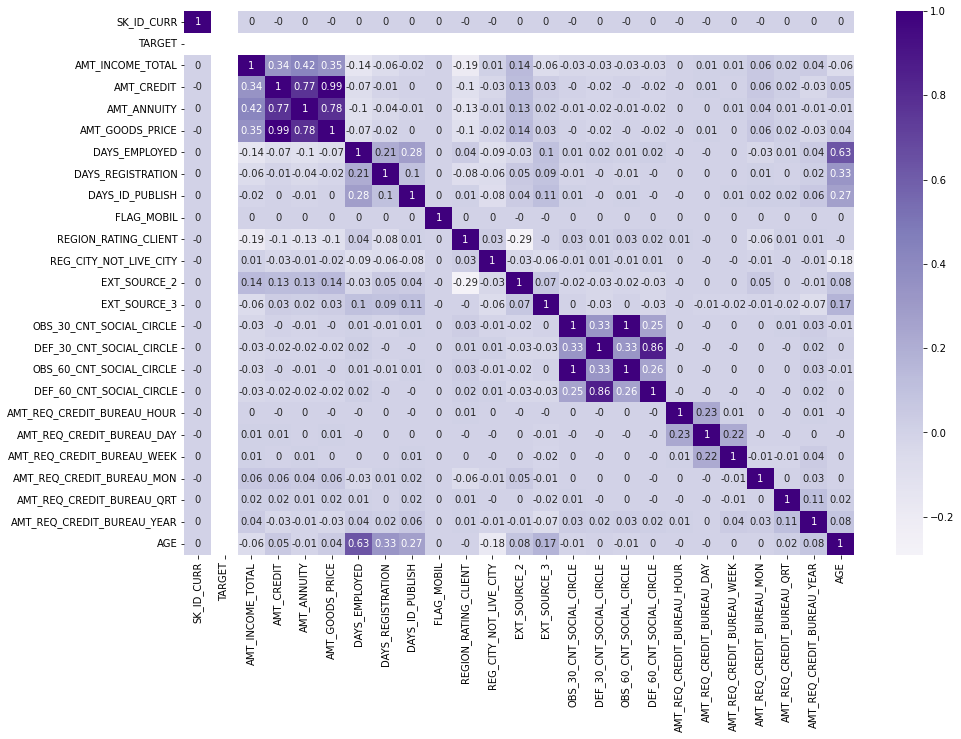

In [135]:
# Plotting a heatmap 
plt.figure(figsize=[15,10])
sns.heatmap(corr_tar0,cmap="Purples",annot=True,center=0.3)
plt.show()

In [136]:
## LETS FIND OUT THE 10 CORRELATION MATRIX
corr0 = corr_tar0.abs().unstack().sort_values(ascending=False).dropna()
corr0=corr0[corr0 !=1]
cordf0=pd.DataFrame(corr0[0:20:2]).reset_index()
cordf0.columns=["VAR1","VAR2","CORR"]
start = "\x1B[1;3m"
end = '\x1B[0m'
print(start+"\n***********Top 10 Correlation for Target = 0-*************"+end)
cordf0


***********Top 10 Correlation for Target = 0-*************


,VAR1,VAR2,CORR
0,AMT_GOODS_PRICE,AMT_CREDIT,0.99
1,DEF_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,0.86
2,AMT_ANNUITY,AMT_GOODS_PRICE,0.78
3,AMT_ANNUITY,AMT_CREDIT,0.77
4,AGE,DAYS_EMPLOYED,0.63
5,AMT_INCOME_TOTAL,AMT_ANNUITY,0.42
6,AMT_INCOME_TOTAL,AMT_GOODS_PRICE,0.35
7,AMT_CREDIT,AMT_INCOME_TOTAL,0.34
8,DAYS_REGISTRATION,AGE,0.33
9,DEF_30_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,0.33


### OBSERVATIONS:
####    1. Goods price & credit amount showing high correlation of 0.99

### Correlation for Target=1

In [137]:
# lets Find corelation Matrix for Defaulters
corr_tar1= round(tar1.corr(),2)
corr_tar1

,SK_ID_CURR,TARGET,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,REGION_RATING_CLIENT,REG_CITY_NOT_LIVE_CITY,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE
SK_ID_CURR,1.00,NaN,-0.01,-0.00,-0.01,-0.00,-0.01,-0.01,0.00,NaN,-0.01,0.01,0.01,-0.00,-0.01,-0.01,-0.01,-0.01,-0.01,-0.01,-0.00,0.01,-0.00,0.01,0.00
TARGET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AMT_INCOME_TOTAL,-0.01,NaN,1.00,0.04,0.05,0.04,-0.01,-0.00,0.00,NaN,-0.02,-0.00,0.01,-0.02,-0.00,-0.01,-0.00,-0.00,0.00,0.00,0.00,0.01,0.00,0.01,-0.00
AMT_CREDIT,-0.00,NaN,0.04,1.00,0.75,0.98,0.00,0.03,0.05,NaN,-0.06,-0.03,0.12,0.05,0.02,-0.03,0.02,-0.03,-0.00,0.00,0.01,0.06,-0.01,-0.01,0.14
AMT_ANNUITY,-0.01,NaN,0.05,0.75,1.00,0.75,-0.08,-0.03,0.02,NaN,-0.07,-0.01,0.12,0.03,0.01,-0.02,0.01,-0.03,0.01,0.00,0.03,0.05,-0.01,-0.01,0.01
AMT_GOODS_PRICE,-0.00,NaN,0.04,0.98,0.75,1.00,0.01,0.03,0.06,NaN,-0.07,-0.03,0.13,0.05,0.02,-0.02,0.02,-0.03,-0.00,0.01,0.01,0.06,-0.01,-0.01,0.14
DAYS_EMPLOYED,-0.01,NaN,-0.01,0.00,-0.08,0.01,1.00,0.19,0.23,NaN,0.00,-0.09,0.00,0.08,-0.01,0.00,-0.01,0.01,-0.01,0.02,0.01,-0.02,0.01,0.03,0.58
DAYS_REGISTRATION,-0.01,NaN,-0.00,0.03,-0.03,0.03,0.19,1.00,0.10,NaN,-0.10,-0.05,0.07,0.07,-0.01,-0.01,-0.01,-0.01,0.00,0.01,-0.00,-0.00,0.01,0.01,0.29
DAYS_ID_PUBLISH,0.00,NaN,0.00,0.05,0.02,0.06,0.23,0.10,1.00,NaN,-0.00,-0.07,0.06,0.08,0.02,-0.01,0.02,-0.00,-0.00,0.01,0.00,0.02,0.01,0.07,0.25
FLAG_MOBIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


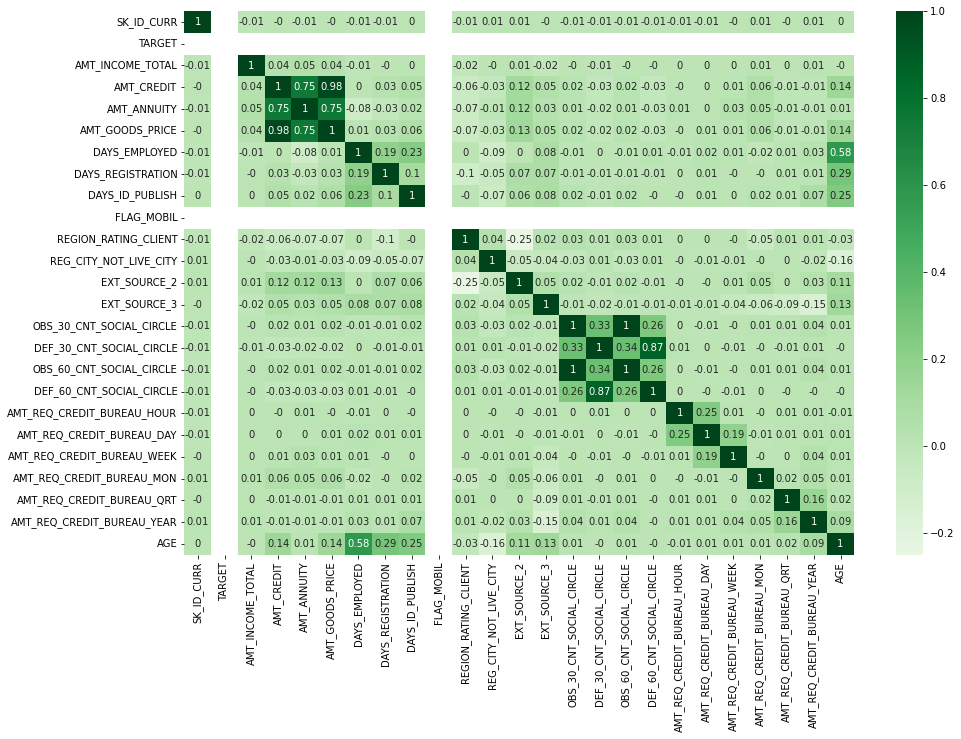

In [138]:
##lets plot a heamap 
plt.figure(figsize=[15,10])
sns.heatmap(corr_tar1,cmap="Greens",annot=True,center=0.3)
plt.show()

In [139]:
## LETS FIND OUT THE 10 CORRELATION MATRIX
corr1 = corr_tar1.abs().unstack().sort_values(ascending=False).dropna()
corr1=corr1[corr1 !=1]
cordf1=pd.DataFrame(corr1[0:20:2]).reset_index()
cordf1.columns=["VAR1","VAR2","CORR"]
start = "\x1B[1;3m"
end = '\x1B[0m'
print(start+"\n***********Top 10 Correlation for Target = 1*************"+end)
cordf1


***********Top 10 Correlation for Target = 1*************


,VAR1,VAR2,CORR
0,AMT_GOODS_PRICE,AMT_CREDIT,0.98
1,DEF_60_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,0.87
2,AMT_ANNUITY,AMT_GOODS_PRICE,0.75
3,AMT_CREDIT,AMT_ANNUITY,0.75
4,DAYS_EMPLOYED,AGE,0.58
5,OBS_60_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,0.34
6,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,0.33
7,AGE,DAYS_REGISTRATION,0.29
8,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,0.26
9,OBS_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,0.26


Goods price amount & credit amount shows high correlation of 0.98

## Previous application dataset importing 

In [140]:
df2=pd.read_csv(r"C:\Users\lenovo pc\Downloads\previous_application.csv")
df2.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [141]:
df2.shape

(1670214, 37)

In [142]:
df2.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [143]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

### checking % of nulls in the dataframe

In [144]:
df2_nulls = ((df2.isna().sum())/len(df2))*100
df2_nulls.sort_values(ascending=False)

RATE_INTEREST_PRIVILEGED       99.643698
RATE_INTEREST_PRIMARY          99.643698
AMT_DOWN_PAYMENT               53.636480
RATE_DOWN_PAYMENT              53.636480
NAME_TYPE_SUITE                49.119754
NFLAG_INSURED_ON_APPROVAL      40.298129
DAYS_TERMINATION               40.298129
DAYS_LAST_DUE                  40.298129
DAYS_LAST_DUE_1ST_VERSION      40.298129
DAYS_FIRST_DUE                 40.298129
DAYS_FIRST_DRAWING             40.298129
AMT_GOODS_PRICE                23.081773
AMT_ANNUITY                    22.286665
CNT_PAYMENT                    22.286366
PRODUCT_COMBINATION             0.020716
AMT_CREDIT                      0.000060
NAME_YIELD_GROUP                0.000000
NAME_PORTFOLIO                  0.000000
NAME_SELLER_INDUSTRY            0.000000
SELLERPLACE_AREA                0.000000
CHANNEL_TYPE                    0.000000
NAME_PRODUCT_TYPE               0.000000
SK_ID_PREV                      0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_CLIENT_TYPE

#### Dropping Null values having morethan 40%

In [145]:
df2.drop(df2_nulls[df2_nulls > 40].index,axis=1,inplace=True)

In [146]:
df2.isna().sum()

SK_ID_PREV                          0
SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
AMT_ANNUITY                    372235
AMT_APPLICATION                     0
AMT_CREDIT                          1
AMT_GOODS_PRICE                385515
WEEKDAY_APPR_PROCESS_START          0
HOUR_APPR_PROCESS_START             0
FLAG_LAST_APPL_PER_CONTRACT         0
NFLAG_LAST_APPL_IN_DAY              0
NAME_CASH_LOAN_PURPOSE              0
NAME_CONTRACT_STATUS                0
DAYS_DECISION                       0
NAME_PAYMENT_TYPE                   0
CODE_REJECT_REASON                  0
NAME_CLIENT_TYPE                    0
NAME_GOODS_CATEGORY                 0
NAME_PORTFOLIO                      0
NAME_PRODUCT_TYPE                   0
CHANNEL_TYPE                        0
SELLERPLACE_AREA                    0
NAME_SELLER_INDUSTRY                0
CNT_PAYMENT                    372230
NAME_YIELD_GROUP                    0
PRODUCT_COMBINATION               346
dtype: int64

In [147]:
df2.shape

(1670214, 26)

## CHECKING & IMPUTING NULLS

### AMT_ANNUITY 


In [148]:
df2.AMT_ANNUITY.value_counts()

2250.000      31865
11250.000     13974
6750.000      13442
9000.000      12496
22500.000     11903
4500.000      10597
13500.000      7171
3375.000       4806
7875.000       4674
38250.000      4129
5625.000       3993
45000.000      3604
10125.000      2558
16875.000      2436
18000.000      1861
29250.000      1662
0.000          1637
12375.000      1634
20250.000      1621
33750.000      1412
15750.000      1370
27000.000      1075
14625.000       864
10492.020       841
36000.000       816
27449.820       731
21709.125       728
5246.010        665
7869.015        653
19151.100       639
25996.365       568
14746.455       564
19125.000       544
24172.650       537
39474.000       532
9830.970        529
9842.400        519
11386.170       514
17079.255       501
40783.995       499
15737.985       496
21375.000       494
24750.000       488
8981.820        486
9426.240        481
52788.780       481
18235.080       470
28465.380       461
20123.865       452
10849.860       447


In [149]:
df2.AMT_ANNUITY.describe()

count    1.297979e+06
mean     1.595512e+04
std      1.478214e+04
min      0.000000e+00
25%      6.321780e+03
50%      1.125000e+04
75%      2.065842e+04
max      4.180581e+05
Name: AMT_ANNUITY, dtype: float64

#### Hence, there is difference between median & mean, lets fill the nulls with median

In [150]:
df2.AMT_ANNUITY = df2.AMT_ANNUITY.fillna(df2.AMT_ANNUITY.median())

In [151]:
df2.AMT_ANNUITY.isna().sum()

0

### AMT_GOODS_PRICE

In [152]:
df2.AMT_GOODS_PRICE.describe()

count    1.284699e+06
mean     2.278473e+05
std      3.153966e+05
min      0.000000e+00
25%      5.084100e+04
50%      1.123200e+05
75%      2.340000e+05
max      6.905160e+06
Name: AMT_GOODS_PRICE, dtype: float64

Hence there is a much difference between median & mean lets fill nulls with median

In [153]:
df2.AMT_GOODS_PRICE = df2.AMT_GOODS_PRICE.fillna(df2.AMT_GOODS_PRICE.median())

In [154]:
df2.AMT_GOODS_PRICE.isna().sum()

0

### CNT_PAYMENT

In [155]:
df2.CNT_PAYMENT.describe()

count    1.297984e+06
mean     1.605408e+01
std      1.456729e+01
min      0.000000e+00
25%      6.000000e+00
50%      1.200000e+01
75%      2.400000e+01
max      8.400000e+01
Name: CNT_PAYMENT, dtype: float64

In [156]:
df2.CNT_PAYMENT.quantile([0.3,0.5,0.75,0.99,1])

0.30     8.0
0.50    12.0
0.75    24.0
0.99    60.0
1.00    84.0
Name: CNT_PAYMENT, dtype: float64

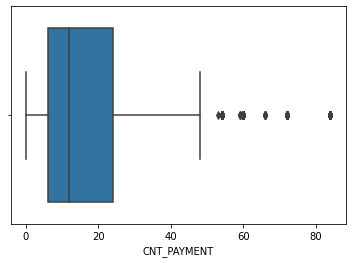

In [157]:
sns.boxplot(df2.CNT_PAYMENT)
plt.show()

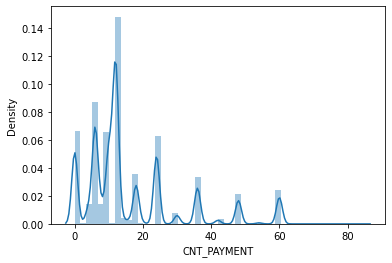

In [158]:
##lets plot a distplot for CNT_PAYMENT column
sns.distplot(df2.CNT_PAYMENT)
plt.show()

#### Hence there is a difference in median & mean which implies presence of outliers 
#### so, lets replace nulls with median.


In [160]:
df2.CNT_PAYMENT=df2.CNT_PAYMENT.fillna(df2.CNT_PAYMENT.median())

In [161]:
df2.CNT_PAYMENT.isna().sum()

0

In [162]:
df2.dtypes


SK_ID_PREV                       int64
SK_ID_CURR                       int64
NAME_CONTRACT_TYPE              object
AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_GOODS_PRICE                float64
WEEKDAY_APPR_PROCESS_START      object
HOUR_APPR_PROCESS_START          int64
FLAG_LAST_APPL_PER_CONTRACT     object
NFLAG_LAST_APPL_IN_DAY           int64
NAME_CASH_LOAN_PURPOSE          object
NAME_CONTRACT_STATUS            object
DAYS_DECISION                    int64
NAME_PAYMENT_TYPE               object
CODE_REJECT_REASON              object
NAME_CLIENT_TYPE                object
NAME_GOODS_CATEGORY             object
NAME_PORTFOLIO                  object
NAME_PRODUCT_TYPE               object
CHANNEL_TYPE                    object
SELLERPLACE_AREA                 int64
NAME_SELLER_INDUSTRY            object
CNT_PAYMENT                    float64
NAME_YIELD_GROUP                object
PRODUCT_COMBINATION      

### NAME_CONTRACT_TYPE

In [163]:
df2.NAME_CONTRACT_TYPE.value_counts()

Cash loans         747553
Consumer loans     729151
Revolving loans    193164
XNA                   346
Name: NAME_CONTRACT_TYPE, dtype: int64

#### Drop XNA

In [164]:
df2=df2.drop(df2[df2["NAME_CASH_LOAN_PURPOSE"]=="XNA"].index)
df2=df2.drop(df2[df2["NAME_CASH_LOAN_PURPOSE"]=="XAP"].index)

In [165]:
# COnverting DAYS_DECISION to positive values.
df2["DAYS_DECISION"]=abs(df2["DAYS_DECISION"])

### OUTLIERS

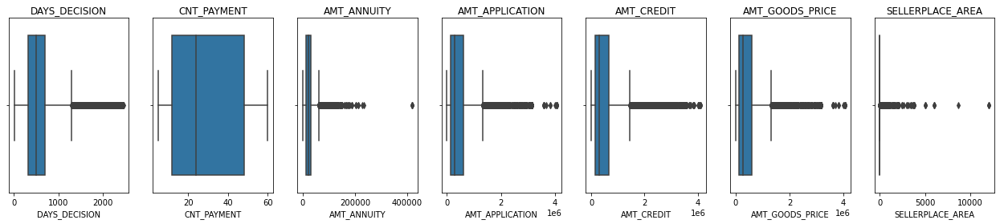

In [166]:
outliers=['DAYS_DECISION','CNT_PAYMENT','AMT_ANNUITY','AMT_APPLICATION','AMT_CREDIT','AMT_GOODS_PRICE','SELLERPLACE_AREA']
plt.figure(figsize=[22,4])
for i in enumerate(outliers):
    plt.subplot(1,7,i[0]+1)
    sns.boxplot(df2[i[1]])
    plt.title(i[1])

#### Observations:
####  1. we can see here CNT_PAYMENT has no outliers.
####  2.'DAYS_DECISION' 'AMT_ANNUITY','AMT_APPLICATION','AMT_CREDIT','AMT_GOODS_PRICE' have very large number of outliers


## Merging Datasets

In [167]:
merged_df=pd.merge(df1,df2,on="SK_ID_CURR",how="inner")

merged_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,REGION_RATING_CLIENT,WEEKDAY_APPR_PROCESS_START_x,REG_CITY_NOT_LIVE_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE,INCOME_RANGE,AMT_CREDIT_BINS,Age_Bins,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_GOODS_PRICE_y,WEEKDAY_APPR_PROCESS_START_y,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,100034,0,Revolving loans,M,N,Y,90000.0,180000.0,9000.0,180000.0,Unaccompanied,Working,Higher education,Single / not married,With parents,1010,4799.0,3015,1,Laborers,2,TUESDAY,0,Business Entity Type 3,0.502779,0.535276,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28,Very Low(<1L),1L-2L,Below 30's,1390369,Cash loans,22430.430,94500.0,109971.0,94500.0,FRIDAY,11,Y,1,Other,Approved,599,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,6.0,high,Cash Street: high
1,100035,0,Cash loans,F,N,Y,292500.0,665892.0,24592.5,477000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,2668,5266.0,3787,1,Laborers,2,WEDNESDAY,0,Business Entity Type 3,0.479987,0.410103,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,42,Medium(2L-3L),6L-10L,In 40's,1344613,Cash loans,33238.800,1260000.0,1260000.0,1260000.0,WEDNESDAY,14,Y,1,Payments on other loans,Refused,119,Cash through the bank,HC,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,60.0,low_action,Cash Street: low
2,100039,0,Cash loans,M,Y,N,360000.0,733315.5,39069.0,679500.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,2060,3557.0,3557,1,Drivers,2,THURSDAY,1,Self-employed,0.321745,0.411849,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,32,High(3L-5L),6L-10L,In 30's,1077565,Cash loans,52513.515,1350000.0,1487214.0,1350000.0,MONDAY,14,Y,1,Buying a used car,Approved,695,Cash through the bank,XAP,Refreshed,XNA,Cash,walk-in,Channel of corporate sales,-1,XNA,42.0,low_normal,Cash Street: low
3,100046,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1223113,Cash loans,28390.635,337500.0,407911.5,337500.0,MONDAY,13,Y,1,Repairs,Approved,539,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,18.0,low_normal,Cash Street: low
4,100046,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1529558,Cash loans,29053.215,450000.0,555723.0,450000.0,MONDAY,15,Y,1,Repairs,Refused,449,Cash through the bank,LIMIT,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,low_normal,Cash Street: low


In [168]:
merged_df.shape


(59413, 65)

In [169]:
## lets rename the columns 
final_df=merged_df.rename({"NAME_CONTRACT_TYPE_x":"NAME_CONTRACT_TYPE","AMT_CREDIT_x":"AMT_CREDIT",
                             "AMT_ANNUITY_x":"AMT_ANNUITY","AMT_GOODS_PRICE_x":"AMT_GOODS_PRICE",
                             "WEEKDAY_APPR_PROCESS_START_x":"WEEKDAY_APPR_PROCESS_START",
                             "NAME_CONTRACT_TYPE_y":"NAME_CONTRACT_TYPE_PRE","AMT_ANNUITY_y":"AMT_ANNUITY_PRE",
                             "AMT_CREDIT_y":"AMT_CREDIT_PRE","AMT_GOODS_PRICE_y":"AMT_GOODS_PRICE_PRE",
                             "WEEKDAY_APPR_PROCESS_START_y":"WEEKDAY_APPR_PROCESS_START_PRE"},axis=1)

In [170]:
final_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,REGION_RATING_CLIENT,WEEKDAY_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE,INCOME_RANGE,AMT_CREDIT_BINS,Age_Bins,SK_ID_PREV,NAME_CONTRACT_TYPE_PRE,AMT_ANNUITY_PRE,AMT_APPLICATION,AMT_CREDIT_PRE,AMT_GOODS_PRICE_PRE,WEEKDAY_APPR_PROCESS_START_PRE,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,100034,0,Revolving loans,M,N,Y,90000.0,180000.0,9000.0,180000.0,Unaccompanied,Working,Higher education,Single / not married,With parents,1010,4799.0,3015,1,Laborers,2,TUESDAY,0,Business Entity Type 3,0.502779,0.535276,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28,Very Low(<1L),1L-2L,Below 30's,1390369,Cash loans,22430.430,94500.0,109971.0,94500.0,FRIDAY,11,Y,1,Other,Approved,599,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,6.0,high,Cash Street: high
1,100035,0,Cash loans,F,N,Y,292500.0,665892.0,24592.5,477000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,2668,5266.0,3787,1,Laborers,2,WEDNESDAY,0,Business Entity Type 3,0.479987,0.410103,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,42,Medium(2L-3L),6L-10L,In 40's,1344613,Cash loans,33238.800,1260000.0,1260000.0,1260000.0,WEDNESDAY,14,Y,1,Payments on other loans,Refused,119,Cash through the bank,HC,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,60.0,low_action,Cash Street: low
2,100039,0,Cash loans,M,Y,N,360000.0,733315.5,39069.0,679500.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,2060,3557.0,3557,1,Drivers,2,THURSDAY,1,Self-employed,0.321745,0.411849,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,32,High(3L-5L),6L-10L,In 30's,1077565,Cash loans,52513.515,1350000.0,1487214.0,1350000.0,MONDAY,14,Y,1,Buying a used car,Approved,695,Cash through the bank,XAP,Refreshed,XNA,Cash,walk-in,Channel of corporate sales,-1,XNA,42.0,low_normal,Cash Street: low
3,100046,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1223113,Cash loans,28390.635,337500.0,407911.5,337500.0,MONDAY,13,Y,1,Repairs,Approved,539,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,18.0,low_normal,Cash Street: low
4,100046,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Unaccompanied,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,0,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1529558,Cash loans,29053.215,450000.0,555723.0,450000.0,MONDAY,15,Y,1,Repairs,Refused,449,Cash through the bank,LIMIT,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,low_normal,Cash Street: low


In [171]:
# lets remove unwanted columns #
final_df.drop(["SK_ID_CURR","NAME_TYPE_SUITE","NAME_TYPE_SUITE","REG_CITY_NOT_LIVE_CITY","HOUR_APPR_PROCESS_START",
                "FLAG_LAST_APPL_PER_CONTRACT","NFLAG_LAST_APPL_IN_DAY"],axis=1,inplace=True)


In [172]:
final_df.shape

(59413, 59)

In [173]:
final_df.describe()

,TARGET,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,REGION_RATING_CLIENT,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE,SK_ID_PREV,AMT_ANNUITY_PRE,AMT_APPLICATION,AMT_CREDIT_PRE,AMT_GOODS_PRICE_PRE,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT
count,59413.000000,5.941300e+04,5.941300e+04,59413.000000,5.941300e+04,59413.000000,59413.000000,59413.000000,59413.0,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,59413.000000,5.941300e+04,59413.000000,5.941300e+04,5.941300e+04,5.941300e+04,59413.000000,59413.000000,59413.000000
mean,0.130258,1.821284e+05,5.598321e+05,26868.441368,5.014153e+05,51119.362867,4639.411713,2943.405349,1.0,2.048323,0.500027,0.448398,1.666790,0.163011,1.648713,0.112349,0.005521,0.006009,0.034841,0.314106,0.323852,3.086059,43.712016,1.935293e+06,25627.835809,4.519988e+05,5.079813e+05,4.519988e+05,631.822833,9.513675,29.486409
std,0.336590,9.810533e+04,3.669192e+05,13611.963059,3.381718e+05,123866.654476,3475.761400,1494.329186,0.0,0.484984,0.196305,0.186038,2.616209,0.481221,2.596003,0.384885,0.078936,0.104505,0.199975,1.136483,0.715293,2.431105,11.262719,5.301690e+05,17389.961864,4.943563e+05,5.396833e+05,4.943563e+05,526.999047,131.046191,17.659998
min,0.000000,2.565000e+04,4.500000e+04,2052.000000,4.500000e+04,5.000000,0.000000,0.000000,1.0,1.000000,0.000006,0.000527,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.000000,1.000125e+06,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,2.000000,-1.000000,5.000000
25%,0.000000,1.125000e+05,2.700000e+05,16911.000000,2.295000e+05,900.000000,1633.000000,1722.000000,1.0,2.000000,0.370921,0.309275,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,34.000000,1.479931e+06,13489.785000,1.350000e+05,1.528200e+05,1.350000e+05,305.000000,-1.000000,12.000000
50%,0.000000,1.575000e+05,4.856400e+05,24948.000000,4.500000e+05,1922.000000,4151.000000,3132.000000,1.0,2.000000,0.552865,0.492060,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,43.000000,1.941703e+06,21361.725000,2.475000e+05,3.049245e+05,2.475000e+05,490.000000,-1.000000,24.000000
75%,0.000000,2.250000e+05,7.551900e+05,34168.500000,6.750000e+05,4367.000000,6972.000000,4240.000000,1.0,2.000000,0.654097,0.554947,2.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,53.000000,2.390904e+06,32598.000000,5.850000e+05,6.750000e+05,5.850000e+05,686.000000,0.000000,48.000000
max,1.000000,2.214117e+06,3.150000e+06,215500.500000,3.150000e+06,365243.000000,20838.000000,6232.000000,1.0,3.000000,0.855000,0.874844,30.000000,6.000000,29.000000,5.000000,2.000000,9.000000,8.000000,24.000000,6.000000,23.000000,69.000000,2.845265e+06,418058.145000,4.050000e+06,4.104351e+06,4.050000e+06,2406.000000,12102.000000,60.000000


## Univariate analysis

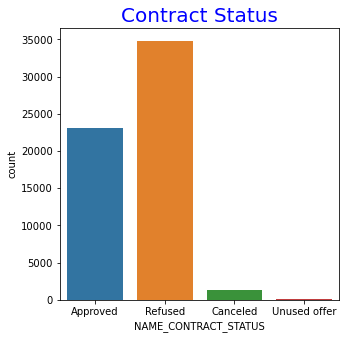

In [174]:
# lets plot a countplot for checking contract status
plt.figure(figsize=[5,5])
sns.countplot(final_df['NAME_CONTRACT_STATUS'])
plt.title("Contract Status",fontdict={'fontsize':20,'color':'blue'})
plt.show()

#### We can see that majority of the loans are refused 

In [175]:
final_df.NAME_CONTRACT_STATUS.describe()

count       59413
unique          4
top       Refused
freq        34786
Name: NAME_CONTRACT_STATUS, dtype: object

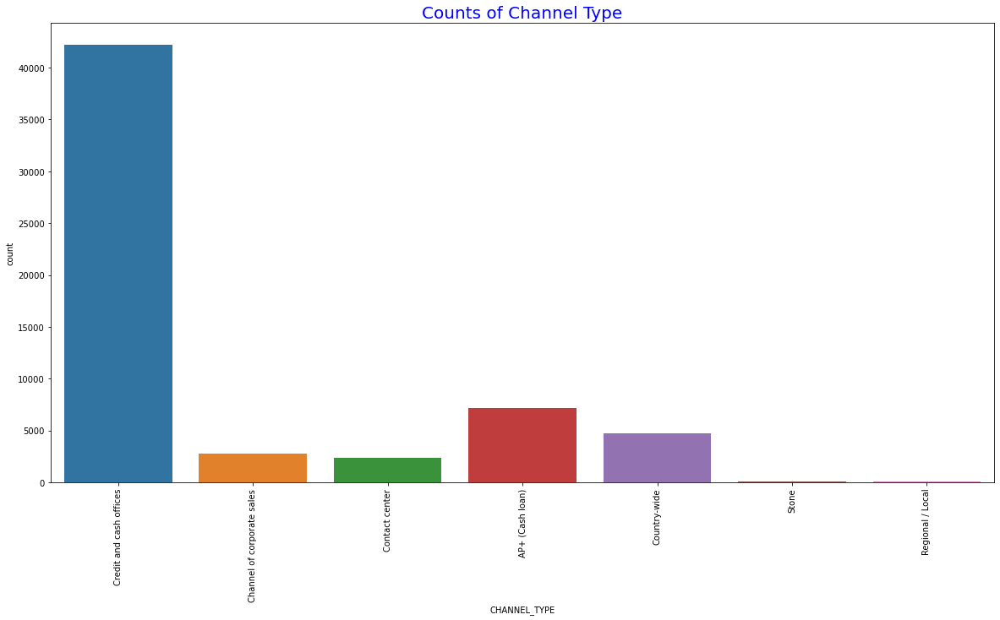

In [176]:
## lets plot a count plot for chanel type
plt.figure(figsize=[20,10])
sns.countplot(final_df['CHANNEL_TYPE'])
plt.xticks(rotation=90)
plt.title("Counts of Channel Type",fontdict={'fontsize':20,'color':'blue'})
plt.show()

##### we can see here credit and cash officers are majority in the dataset with channel type

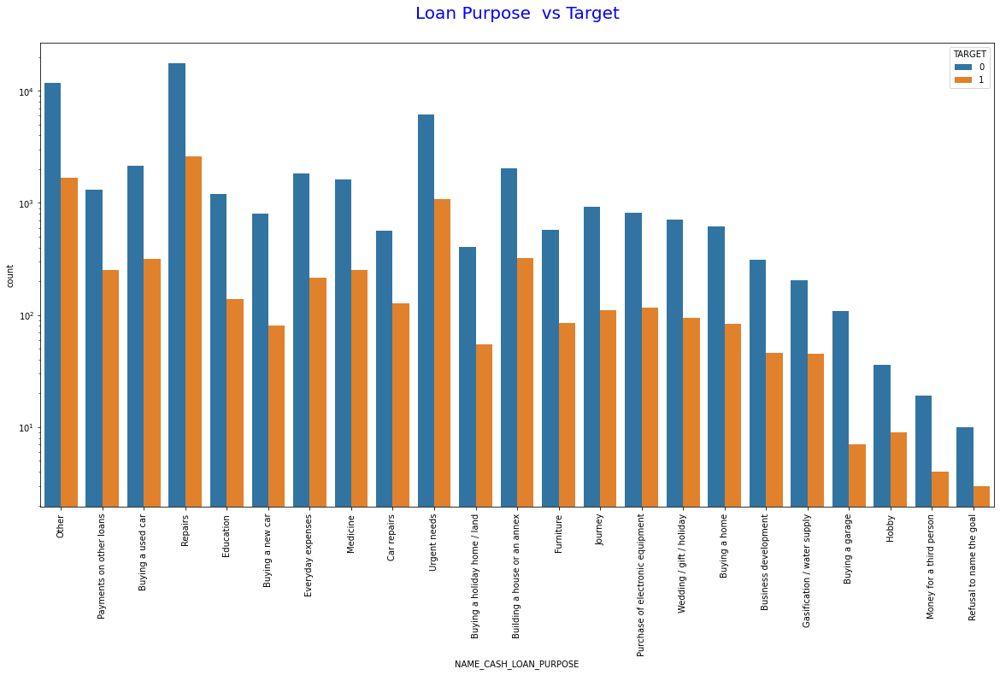

In [177]:
# Lets Plot a countplot for Loan purpose wrt Target variable.

plt.figure(figsize=[20,10])
sns.countplot(final_df['NAME_CASH_LOAN_PURPOSE'],hue=final_df["TARGET"])
plt.yscale("log")
plt.xticks(rotation=90)
plt.title("Loan Purpose  vs Target\n",fontdict={'fontsize':20,'color':'blue'})
plt.show()

##### 1.we can observe for repairs the loans have been faced difficulties
#####  2.people who Refused to name the goal has paid the loan
##### 3-Education and money to a third person have almost equal number of approvals and rejections.*

### Bivariate analysis

In [178]:
final_df.head()

,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,REGION_RATING_CLIENT,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE,INCOME_RANGE,AMT_CREDIT_BINS,Age_Bins,SK_ID_PREV,NAME_CONTRACT_TYPE_PRE,AMT_ANNUITY_PRE,AMT_APPLICATION,AMT_CREDIT_PRE,AMT_GOODS_PRICE_PRE,WEEKDAY_APPR_PROCESS_START_PRE,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,0,Revolving loans,M,N,Y,90000.0,180000.0,9000.0,180000.0,Working,Higher education,Single / not married,With parents,1010,4799.0,3015,1,Laborers,2,TUESDAY,Business Entity Type 3,0.502779,0.535276,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,28,Very Low(<1L),1L-2L,Below 30's,1390369,Cash loans,22430.430,94500.0,109971.0,94500.0,FRIDAY,Other,Approved,599,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,6.0,high,Cash Street: high
1,0,Cash loans,F,N,Y,292500.0,665892.0,24592.5,477000.0,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,2668,5266.0,3787,1,Laborers,2,WEDNESDAY,Business Entity Type 3,0.479987,0.410103,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,42,Medium(2L-3L),6L-10L,In 40's,1344613,Cash loans,33238.800,1260000.0,1260000.0,1260000.0,WEDNESDAY,Payments on other loans,Refused,119,Cash through the bank,HC,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,60.0,low_action,Cash Street: low
2,0,Cash loans,M,Y,N,360000.0,733315.5,39069.0,679500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,2060,3557.0,3557,1,Drivers,2,THURSDAY,Self-employed,0.321745,0.411849,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,32,High(3L-5L),6L-10L,In 30's,1077565,Cash loans,52513.515,1350000.0,1487214.0,1350000.0,MONDAY,Buying a used car,Approved,695,Cash through the bank,XAP,Refreshed,XNA,Cash,walk-in,Channel of corporate sales,-1,XNA,42.0,low_normal,Cash Street: low
3,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1223113,Cash loans,28390.635,337500.0,407911.5,337500.0,MONDAY,Repairs,Approved,539,Cash through the bank,XAP,New,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,18.0,low_normal,Cash Street: low
4,0,Revolving loans,M,Y,Y,180000.0,540000.0,27000.0,540000.0,Working,Higher education,Married,House / apartment,1761,8236.0,4292,1,Managers,2,TUESDAY,Business Entity Type 3,0.738053,0.605836,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,44,Low(1L-2L),4L-6L,In 40's,1529558,Cash loans,29053.215,450000.0,555723.0,450000.0,MONDAY,Repairs,Refused,449,Cash through the bank,LIMIT,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,low_normal,Cash Street: low


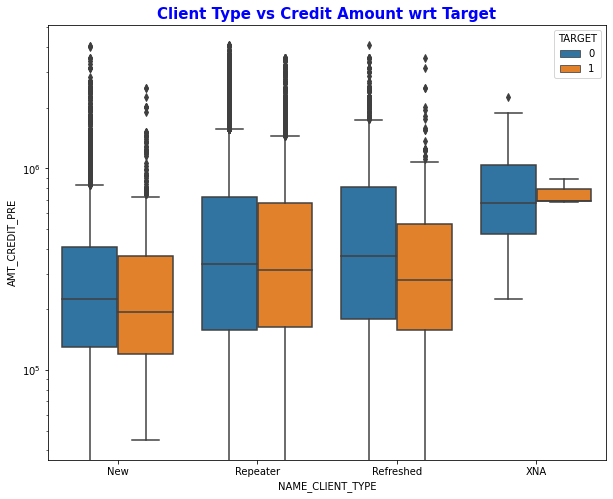

In [179]:
# lets a boxplot for client type Vs their credit amount wrt Target variable

plt.figure(figsize=[10,8])
sns.boxplot(x=final_df.NAME_CLIENT_TYPE,y=final_df.AMT_CREDIT_PRE,hue=final_df.TARGET)
plt.title("Client Type vs Credit Amount wrt Target",fontdict={'fontsize':15,'color':'blue',"fontweight":"bold"})
plt.yscale("log")
plt.show()

#### we can observe here that for new applicants credit amount was loan where median is there.

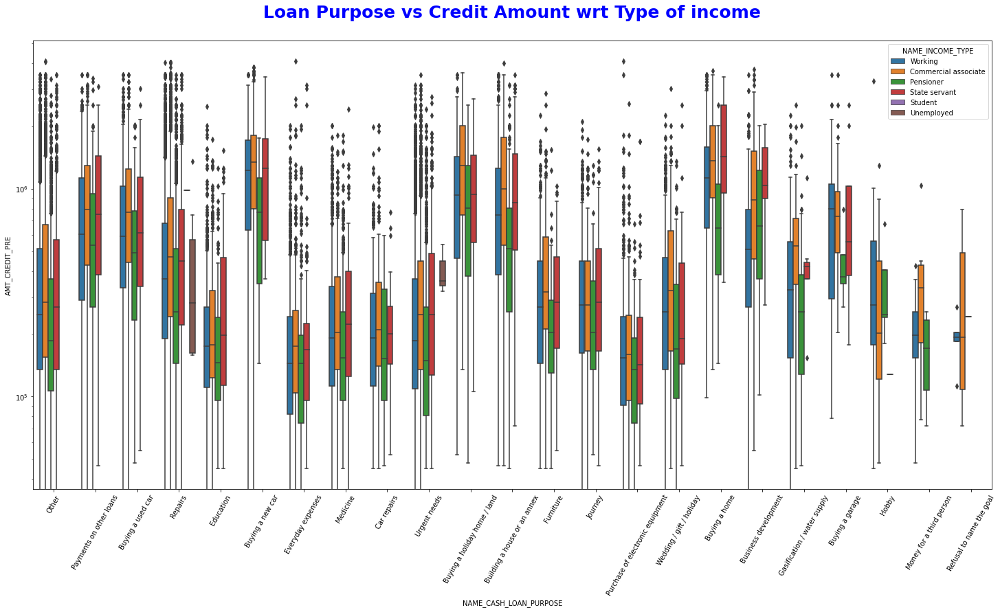

In [180]:
# lets plot a boxplot for Loan Purpose Vs their credit amount wrt Target variable

plt.figure(figsize=[25,12])
sns.boxplot(x=final_df.NAME_CASH_LOAN_PURPOSE,y=final_df.AMT_CREDIT_PRE,hue=final_df.NAME_INCOME_TYPE)
plt.title("Loan Purpose vs Credit Amount wrt Type of income\n",fontdict={'fontsize':25,"fontweight":"bold",'color':'blue'})
plt.xticks(rotation=60)
plt.yscale("log")
plt.show()

#### 1.we can see for nuying a home occupation STATES servent took high credit loans
#### 2.For everyday expenses the credit amount was low 

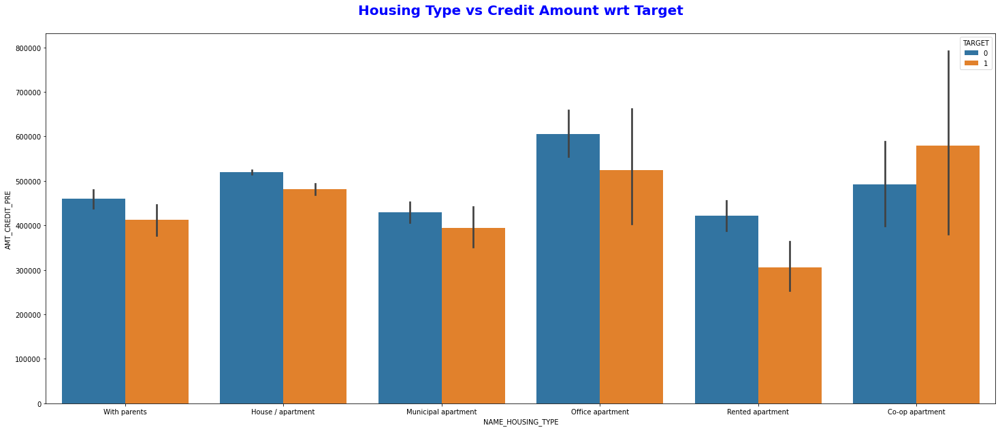

In [181]:
# lets plot a barplot for Housing type Vs their credit amount wrt Target variable

plt.figure(figsize=[25,10])
sns.barplot(x=final_df.NAME_HOUSING_TYPE,y=final_df.AMT_CREDIT_PRE,hue=final_df.TARGET)
plt.title("Housing Type vs Credit Amount wrt Target\n",fontdict={'fontsize':20,"fontweight":"bold",'color':'blue'})
plt.show()

##### 1.For rented apartment the defaulters are less 
##### 2.For Co-Operative apartments the default in repaying loans is high hence we can suggest banks not to sanction loans for them

### CONCLUSION 

### 1.We can see there are 18% applicants with employement days as '365243'.
### 2.We have found that imbalance ratio is of  On-time payers & Defaulters - (92:8) =11.5:1
### 3.Banks should prefer sanctioning revolving loans because of less defaulter we have observed.
### 4.People with more than 5lakhs income find less difficulty to pay on time.
### 5.Credit loans in the range of 2-4l lakhs were paid on time.
### 6.Applicants in the age of 30's paying loans on-time.
### 7.Applicants who living co-operative society shows less defaulters.
### 8.security ministers, religion, military, services, electricity is some professions with comparatively less majority
###   in defaulter.
### 9.Region rating has a majority of on-time payers.
### 10.Academic degree holders shows less defaulters.
### 11.Goods price & credit amounts shows most correlation.
### 12.We can see to buy a house/apartments with states service professions are paid on-time.
